# Candy Distributor Analysis

This notebook analyzes candy distributor data, performs EDA, merges datasets, and prepares data for modeling.

## 1. Imports & Setup

In [1]:
# ===============================
# STEP 1: Imports & Settings
# ===============================
import pandas as pd
import numpy as np
import folium
from folium.plugins import HeatMap
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
from IPython.display import IFrame, display, HTML
from haversine import haversine
from sklearn.model_selection import train_test_split, cross_val_score, KFold, GridSearchCV
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler
from statsmodels.tsa.seasonal import seasonal_decompose
import ipywidgets as widgets
from IPython.display import display, clear_output

# Configure pandas display options for better DataFrame visibility (no truncation, show all rows, and wider columns)
pd.set_option('display.max_columns', None) 
pd.set_option('display.max_rows', None)
pd.set_option('display.max_colwidth', None)


## 2. Load & Inspect Data

In [2]:
# ===============================
# STEP 2: Load Data
# ===============================

factories = pd.read_csv('data/Candy_Factories.csv')
products = pd.read_csv('data/Candy_Products.csv')
sales = pd.read_csv('data/Candy_Sales.csv')
targets = pd.read_csv('data/Candy_Targets.csv')
uszips = pd.read_csv('data/uszips.csv')

In [3]:
# Check shapes and missing values
print(sales.info())
print(products.info())
print(factories.info())
print(targets.info())
print(uszips.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10194 entries, 0 to 10193
Data columns (total 18 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Row ID          10194 non-null  int64  
 1   Order ID        10194 non-null  object 
 2   Order Date      10194 non-null  object 
 3   Ship Date       10194 non-null  object 
 4   Ship Mode       10194 non-null  object 
 5   Customer ID     10194 non-null  int64  
 6   Country/Region  10194 non-null  object 
 7   City            10194 non-null  object 
 8   State/Province  10194 non-null  object 
 9   Postal Code     10194 non-null  object 
 10  Division        10194 non-null  object 
 11  Region          10194 non-null  object 
 12  Product ID      10194 non-null  object 
 13  Product Name    10194 non-null  object 
 14  Sales           10194 non-null  float64
 15  Units           10194 non-null  int64  
 16  Gross Profit    10194 non-null  float64
 17  Cost            10194 non-null 

In [4]:
# Quick overview
factories.head()
products.head()
sales.head()
targets.head()
uszips.head()


,zip,lat,lng,city,state_id,state_name,zcta,parent_zcta,population,density,county_fips,county_name,county_weights,county_names_all,county_fips_all,imprecise,military,timezone
0,601,18.18027,-66.75266,Adjuntas,PR,Puerto Rico,True,NaN,16834.0,100.9,72001,Adjuntas,"{""72001"": 98.74, ""72141"": 1.26}",Adjuntas|Utuado,72001|72141,False,False,America/Puerto_Rico
1,602,18.36075,-67.17541,Aguada,PR,Puerto Rico,True,NaN,37642.0,479.2,72003,Aguada,"{""72003"": 100}",Aguada,72003,False,False,America/Puerto_Rico
2,603,18.45744,-67.12225,Aguadilla,PR,Puerto Rico,True,NaN,49075.0,551.7,72005,Aguadilla,"{""72005"": 99.76, ""72099"": 0.24}",Aguadilla|Moca,72005|72099,False,False,America/Puerto_Rico
3,606,18.16585,-66.93716,Maricao,PR,Puerto Rico,True,NaN,5590.0,48.7,72093,Maricao,"{""72093"": 82.27, ""72153"": 11.66, ""72121"": 6.06}",Maricao|Yauco|Sabana Grande,72093|72153|72121,False,False,America/Puerto_Rico
4,610,18.29110,-67.12243,Anasco,PR,Puerto Rico,True,NaN,25542.0,265.7,72011,Añasco,"{""72011"": 96.71, ""72099"": 2.82, ""72083"": 0.37, ""72003"": 0.1}",Añasco|Moca|Las Marías|Aguada,72011|72099|72083|72003,False,False,America/Puerto_Rico


## 3. Data Cleaning & Preparation

In [5]:
# =================================================================
# STEP 3: DATA CLEANING & PREPARATION
# ==================================================================
# --- Standardize Data Formats ---

# Convert date columns to datetime objects
sales['Order Date'] = pd.to_datetime(sales['Order Date'])
sales['Ship Date'] = pd.to_datetime(sales['Ship Date'])

# Standardize Postal Code
sales['Postal Code'] = sales['Postal Code'].astype(str).str.strip().str.zfill(5)
uszips['zip'] = uszips['zip'].astype(str).str.zfill(5)

In [6]:
# --- Merge datasets into a single DataFrame ---
sales_df = (
    sales
    # Customer geolocation
    .merge(uszips[['zip', 'lat', 'lng']], left_on='Postal Code', right_on='zip', how='left')
    .rename(columns={'lat': 'lat_customer', 'lng': 'lng_customer'})
    
    # Add factory info via Product
    .merge(products[['Product ID', 'Factory']], on='Product ID', how='left')
    
    # Add factory coordinates
    .merge(factories.rename(columns={'Latitude': 'lat_factory', 'Longitude': 'lng_factory'}),
           on='Factory', how='left')
    
    # Add targets by Division
    .merge(targets[['Division', 'Target']], on='Division', how='left')
   
    # Drop redundant'zip' column after merging
    .drop(columns=['zip']) 
)


In [7]:
# --- Check final columns ---
print(sales_df.columns)

# Show only columns that have missing values
missing_cols = sales_df.isna().sum()
missing_cols = missing_cols[missing_cols > 0]
print(missing_cols)

Index(['Row ID', 'Order ID', 'Order Date', 'Ship Date', 'Ship Mode',
       'Customer ID', 'Country/Region', 'City', 'State/Province',
       'Postal Code', 'Division', 'Region', 'Product ID', 'Product Name',
       'Sales', 'Units', 'Gross Profit', 'Cost', 'lat_customer',
       'lng_customer', 'Factory', 'lat_factory', 'lng_factory', 'Target'],
      dtype='object')
lat_customer    200
lng_customer    200
dtype: int64


In [8]:
# ================================================================
# HANDLE MISSING GEOLOCATION DATA FOR CANADIAN CUSTOMERS 
# ================================================================

# ---- Load Canada postal code reference ----
canada_ref = pd.read_csv('/Users/debbiego/Desktop/Myfolder/Capstone/data/canada_postal_codes.csv')

# ------ Normalize column names for consistency ---------
sales_df.rename(columns={
    'City': 'city',
    'Postal Code': 'postal_code'
}, inplace=True)

canada_ref.columns = canada_ref.columns.str.strip().str.lower()
canada_ref.rename(columns={
    'city': 'city',
    'postal code': 'postal_code',
    'latitude': 'lat_customer',
    'longitude': 'lng_customer'
}, inplace=True)

# ------ Clean and standardize formatting for merging ---------
# City names
sales_df['city'] = sales_df['city'].astype(str).str.strip().str.title()
canada_ref['city'] = canada_ref['city'].astype(str).str.strip().str.title()

# Postal codes: remove spaces and uppercase
sales_df['postal_code'] = sales_df['postal_code'].astype(str).str.replace(' ', '').str.upper()
canada_ref['postal_code'] = canada_ref['postal_code'].astype(str).str.replace(' ', '').str.upper()

# ------ Split rows by country ------
canada_rows = sales_df[sales_df['Country/Region'].str.contains('Canada', case=False, na=False)].copy()
us_rows = sales_df[~sales_df['Country/Region'].str.contains('Canada', case=False, na=False)].copy()

# ------ STEP 3.1: Merge Canadian lat/lng using postal_code ------
canada_rows = canada_rows.merge(
    canada_ref[['postal_code', 'lat_customer', 'lng_customer']],
    on='postal_code',
    how='left',
    suffixes=('', '_ref')
)

# Fill missing values using postal code reference
canada_rows['lat_customer'] = canada_rows['lat_customer'].fillna(canada_rows['lat_customer_ref'])
canada_rows['lng_customer'] = canada_rows['lng_customer'].fillna(canada_rows['lng_customer_ref'])
canada_rows.drop(columns=['lat_customer_ref', 'lng_customer_ref'], inplace=True)

# ------ STEP 3.2: Fallback merge for remaining missing using city ------
missing_after_postal = canada_rows[
    canada_rows['lat_customer'].isna() | canada_rows['lng_customer'].isna()
].copy()

if not missing_after_postal.empty:
    city_fallback = canada_ref.groupby('city')[['lat_customer', 'lng_customer']].first().reset_index()
    missing_after_postal = missing_after_postal.merge(
        city_fallback,
        on='city',
        how='left',
        suffixes=('', '_city')
    )
    missing_after_postal['lat_customer'] = missing_after_postal['lat_customer'].fillna(missing_after_postal['lat_customer_city'])
    missing_after_postal['lng_customer'] = missing_after_postal['lng_customer'].fillna(missing_after_postal['lng_customer_city'])
    missing_after_postal.drop(columns=['lat_customer_city', 'lng_customer_city'], inplace=True)

    # Replace the missing rows with the updated version
    canada_rows.update(missing_after_postal)

# ------ Combine back into final DataFrame ------
sales_df = pd.concat([us_rows, canada_rows], ignore_index=True)

# ------ Clean up if previous runs had extra columns ------
if 'location_missing' in sales_df.columns:
    sales_df.drop(columns=['location_missing'], inplace=True)

# ------ Final check ------
missing = sales_df[sales_df['lat_customer'].isna() | sales_df['lng_customer'].isna()]
print(f"Number of rows still missing lat/lng: {len(missing)}")
if len(missing) > 0:
    print(missing.head(20))

# ------ Save final CSV ------
sales_df.to_csv('/Users/debbiego/Desktop/Myfolder/Capstone/data/sales_df_final.csv', index=False)
print("Canadian geolocations filled using hybrid (postal code + city fallback). Final dataset saved.")


Number of rows still missing lat/lng: 0
Canadian geolocations filled using hybrid (postal code + city fallback). Final dataset saved.


In [9]:
sales_df.head()


,Row ID,Order ID,Order Date,Ship Date,Ship Mode,Customer ID,Country/Region,city,State/Province,postal_code,Division,Region,Product ID,Product Name,Sales,Units,Gross Profit,Cost,lat_customer,lng_customer,Factory,lat_factory,lng_factory,Target
0,282,US-2021-128055-CHO-TRI-54000,2021-03-31,2026-09-26,Standard Class,128055,United States,San Francisco,California,94122,Chocolate,Pacific,CHO-TRI-54000,Wonka Bar - Triple Dazzle Caramel,7.50,2,4.90,2.60,37.76113,-122.48433,Wicked Choccy's,32.076176,-81.088371,27000
1,288,US-2021-128055-CHO-SCR-58000,2021-03-31,2026-09-26,Standard Class,128055,United States,San Francisco,California,94122,Chocolate,Pacific,CHO-SCR-58000,Wonka Bar -Scrumdiddlyumptious,7.20,2,5.00,2.20,37.76113,-122.48433,Lot's O' Nuts,32.881893,-111.768036,27000
2,1132,US-2021-138100-CHO-FUD-51000,2021-09-15,2027-03-13,Standard Class,138100,United States,New York City,New York,10011,Chocolate,Atlantic,CHO-FUD-51000,Wonka Bar - Fudge Mallows,7.20,2,4.80,2.40,40.74173,-74.00037,Lot's O' Nuts,32.881893,-111.768036,27000
3,1133,US-2021-138100-CHO-MIL-31000,2021-09-15,2027-03-13,Standard Class,138100,United States,New York City,New York,10011,Chocolate,Atlantic,CHO-MIL-31000,Wonka Bar - Milk Chocolate,9.75,3,6.33,3.42,40.74173,-74.00037,Wicked Choccy's,32.076176,-81.088371,27000
4,3396,US-2022-121391-CHO-MIL-31000,2022-10-04,2028-03-29,First Class,121391,United States,San Francisco,California,94109,Chocolate,Pacific,CHO-MIL-31000,Wonka Bar - Milk Chocolate,6.50,2,4.22,2.28,37.79334,-122.42138,Wicked Choccy's,32.076176,-81.088371,27000


## 4. Feature Engineering and Exploratory Data Analysis (EDA)
Steps taken:
1. Added Key Metrics 
2. Groupby & Aggregations
3. Geospatial Calculations & Visualization 



In [10]:
# ==============================================================================
# STEP 4.1 FEATURE ENGINEERING
# ==============================================================================

# --- Haversine Distance Calculation ---
# Compute distance from assigned factory to customer
def haversine_vectorized(lat1, lon1, lat2, lon2):
    R = 3958.8  # miles
    phi1, phi2 = np.radians(lat1), np.radians(lat2)
    delta_lambda = np.radians(lon2 - lon1)

    # Haversine formula
    a = np.sin(np.radians(lat2 - lat1)/2)**2 + np.cos(phi1)*np.cos(phi2)*np.sin(delta_lambda/2)**2
    return 2*R*np.arcsin(np.sqrt(a))

# Apply the distance calculation
sales_df['distance_miles'] = haversine_vectorized(
    sales_df['lat_factory'], sales_df['lng_factory'],
    sales_df['lat_customer'], sales_df['lng_customer']
)

# --- Financial & Efficiency Metrics ---
# Avoid division by zero
sales_df = sales_df[sales_df['distance_miles'] > 0]

sales_df['cost_per_mile']   = sales_df['Cost'] / sales_df['distance_miles']
sales_df['profit_per_mile'] = sales_df['Gross Profit'] / sales_df['distance_miles']
sales_df['profit_per_unit'] = sales_df['Gross Profit'] / sales_df['Units']

# --- Time-Based Feature ---
sales_df['days_to_ship'] = (sales_df['Ship Date'] - sales_df['Order Date']).dt.days

print("\nFeature engineering complete. New columns created.")
print(sales_df[['distance_miles', 'cost_per_mile', 'profit_per_mile', 'profit_per_unit', 'days_to_ship']].head())



Feature engineering complete. New columns created.
   distance_miles  cost_per_mile  profit_per_mile  profit_per_unit  \
0     2358.537678       0.001102         0.002078             2.45   
1      691.174953       0.003183         0.007234             2.50   
2     2140.848363       0.001121         0.002242             2.40   
3      716.230343       0.004775         0.008838             2.11   
4     2354.985141       0.000968         0.001792             2.11   

   days_to_ship  
0          2005  
1          2005  
2          2005  
3          2005  
4          2003  


In [11]:
# ==============================================================================
# STEP 4.2 EXPLORATORY DATA ANALYSIS (EDA) & VISUALIZATION
# ==============================================================================

# --- 1. Key Performance Indicator (KPI) Summary ---
def create_summary_bar_chart(df, group_col, value_col, title):
    """Creates a standardized summary bar chart using Plotly."""
    summary_df = df.groupby(group_col)[value_col].sum().reset_index().sort_values(by=value_col, ascending=False)
    
    fig = px.bar(
        summary_df,
        x=group_col,
        y=value_col,
        title=title,
        labels={value_col: f'Total {value_col} ($)', group_col: group_col},
        template='plotly_white',
        color=value_col,
        color_continuous_scale=px.colors.sequential.Viridis
    )
    fig.update_layout(yaxis_tickformat=',')
    fig.update_traces(hovertemplate=f'%{{x}}<br>{value_col}: $%{{y:,.0f}}<extra></extra>')
    fig.show()

# --- Key Sales Performance Visualizations ---
create_summary_bar_chart(sales_df, 'Product Name', 'Sales', 'Total Sales by Product')
create_summary_bar_chart(sales_df, 'Division', 'Sales', 'Total Sales by Division')
create_summary_bar_chart(sales_df, 'Region', 'Sales', 'Total Sales by Region')

# --- 2. Profitability Analysis  ---
profit_vs_sales = sales_df.groupby('Division')[['Sales', 'Gross Profit']].sum().reset_index()

fig_profit_sales = px.bar(
    profit_vs_sales,
    x='Division',
    y=['Sales', 'Gross Profit'],
    barmode='group',
    title='Gross Profit vs Sales by Division',
    labels={'value':'Amount ($)', 'variable':'Legend'},
    template='plotly_white',
    color_discrete_map={'Sales':'#1f77b4','Gross Profit':'#2ca02c'}
)
fig_profit_sales.update_layout(
    yaxis_tickformat=',',
    xaxis_title='Division',
    yaxis_title='Amount ($)'
)
# Format hover for both metrics
fig_profit_sales.update_traces(
    hovertemplate='%{x}<br>%{y:,.0f}<extra>%{customdata}</extra>'
)
# Add customdata to differentiate metrics
fig_profit_sales.for_each_trace(lambda t: t.update(hovertemplate=f'%{{x}}<br>{t.name}: $%{{y:,.0f}}<extra></extra>'))

fig_profit_sales.show()



In [12]:
print(sales_df['Order Date'].min(), sales_df['Order Date'].max())
print(sales_df['Ship Date'].min(), sales_df['Ship Date'].max())

# Check days_to_ship distribution
sales_df['days_to_ship'] = (pd.to_datetime(sales_df['Ship Date']) - pd.to_datetime(sales_df['Order Date'])).dt.days
print(sales_df['days_to_ship'].describe())


2021-01-03 00:00:00 2024-12-30 00:00:00
2026-06-30 00:00:00 2030-06-28 00:00:00
count    10194.000000
mean      2003.961840
std          1.744106
min       2000.000000
25%       2003.000000
50%       2004.000000
75%       2005.000000
max       2011.000000
Name: days_to_ship, dtype: float64


Average distance per factory:
 Factory
Lot's O' Nuts        1331.461852
Wicked Choccy's      1169.047814
Sugar Shack          1116.331507
The Other Factory    1021.694780
Secret Factory        896.491369
Name: distance_miles, dtype: float64


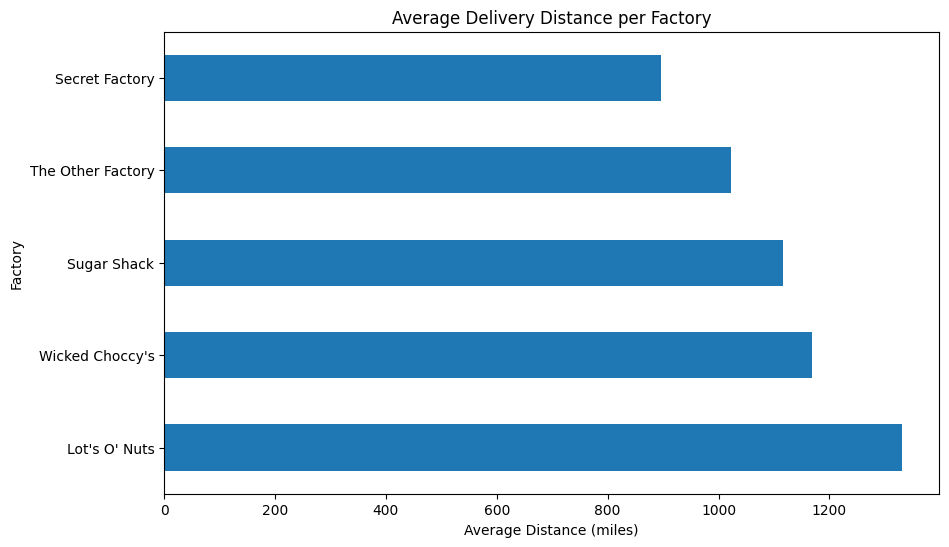

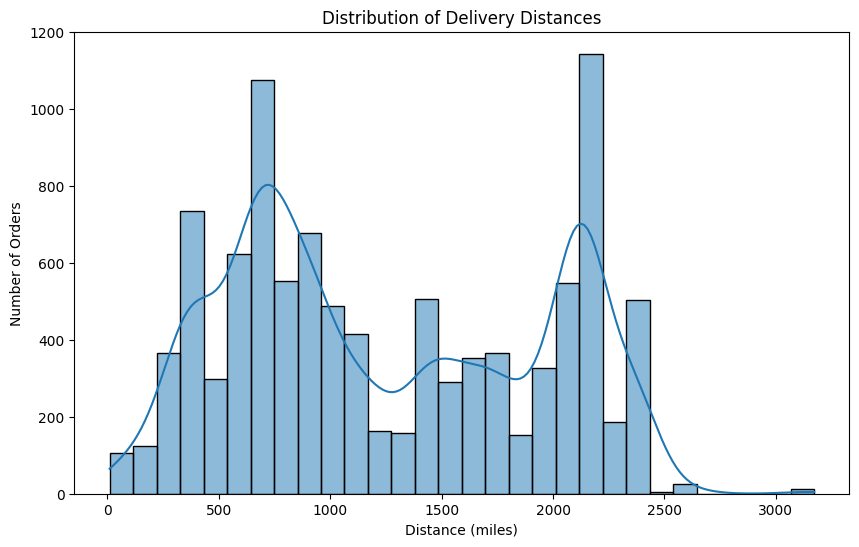

In [13]:
# --- 3. Distance Analysis ---
factory_distance_avg = sales_df.groupby('Factory')['distance_miles'].mean().sort_values(ascending=False)
print("Average distance per factory:\n", factory_distance_avg)

# Visualizations
plt.figure(figsize=(10, 6))
factory_distance_avg.plot(kind='barh', title='Average Delivery Distance per Factory')
plt.xlabel('Average Distance (miles)')
plt.ylabel('Factory')
plt.show()

# --- 4. Distance Distribution ---
plt.figure(figsize=(10, 6))
sns.histplot(sales_df['distance_miles'], bins=30, kde=True)
plt.title('Distribution of Delivery Distances')
plt.xlabel('Distance (miles)')
plt.ylabel('Number of Orders')
plt.show()



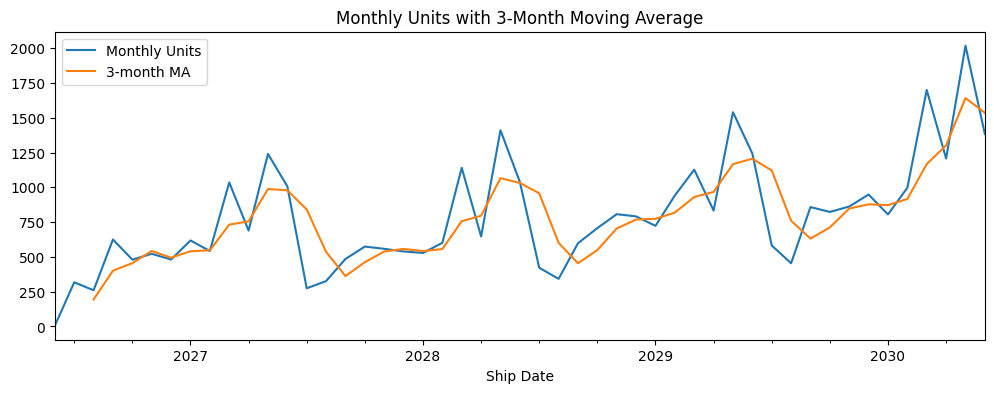

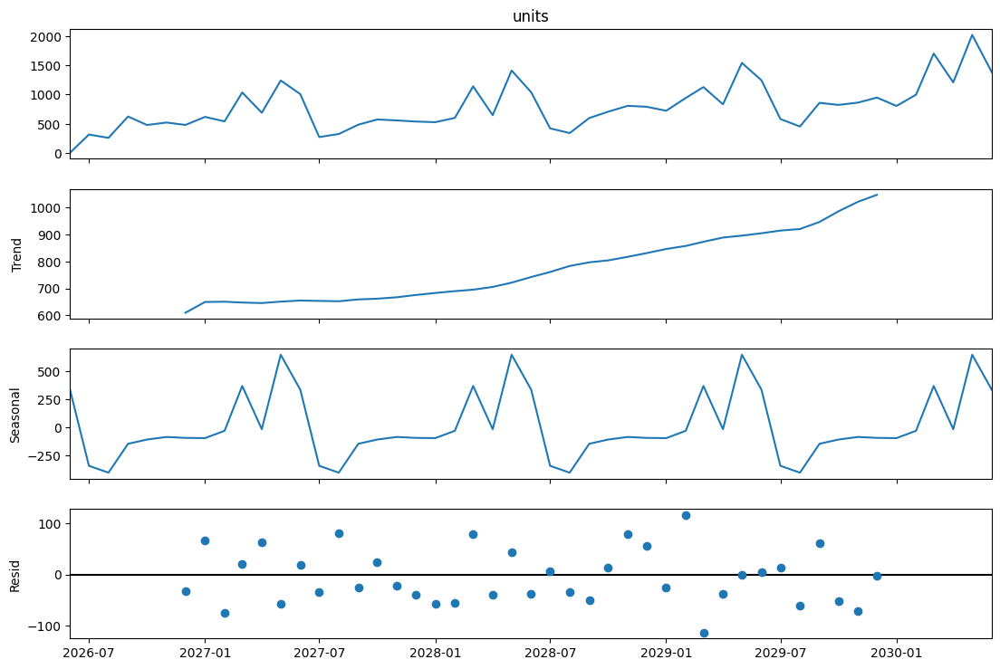

--- Monthly Unit Sales Stats ---


count      49.00
mean      788.86
std       399.02
min         5.00
25%       528.00
50%       707.00
75%      1007.00
max      2018.00
Name: units, dtype: float64


--- Trend Component Stats ---


count      37.00
mean      773.20
std       123.80
min       609.58
25%       659.04
50%       742.17
75%       873.00
max      1047.29
Name: trend, dtype: float64

In [14]:
# --- 5. Time Series/Seasonal Analysis  ---

sales_df['Ship Date'] = pd.to_datetime(sales_df['Ship Date'])
monthly = sales_df.groupby(pd.Grouper(key='Ship Date', freq='MS'))['Units'].sum().rename('units').to_frame()

# Monthly trend
plt.figure(figsize=(12,4))
monthly['units'].plot(label='Monthly Units')
monthly['units'].rolling(3).mean().plot(label='3-month MA')
plt.legend(); plt.title('Monthly Units with 3-Month Moving Average'); plt.show()

from statsmodels.tsa.seasonal import seasonal_decompose
dec = seasonal_decompose(monthly['units'].replace(0, np.nan).interpolate(), model='additive', period=12)
fig = dec.plot(); fig.set_size_inches(12,8); plt.show()

# Print to see the actual data ranges
print("--- Monthly Unit Sales Stats ---")
display(monthly['units'].describe().round(2))

print("\n--- Trend Component Stats ---")
display(dec.trend.describe().round(2))

Top 5 Shortest Delivery Routes:
                           Order ID  distance_miles
7835  US-2022-153038-OTH-KAZ-38000       10.928800
5770  US-2024-129707-CHO-SCR-58000       31.148278
6978  US-2021-138177-CHO-SCR-58000       31.148278
2260  US-2022-112144-CHO-NUT-13000       33.406913
2261  US-2022-112144-CHO-NUT-13000       33.406913

Top 5 Longest Delivery Routes:
                            Order ID  distance_miles
10114  CA-2021-153623-CHO-SCR-58000     3171.639768
10115  CA-2021-153623-CHO-SCR-58000     3171.639768
10116  CA-2021-146626-CHO-SCR-58000     3171.639768
10117  CA-2023-124626-CHO-SCR-58000     3171.639768
10118  CA-2024-124626-CHO-SCR-58000     3171.639768
--- Top 10 Most Efficient Shipping Routes (by Profit per Unit) ---\n
           Factory State/Province  total_gross_profit  total_units  \
64  Secret Factory       Delaware                30.0            3   
59  Secret Factory        Arizona               320.0           32   
75  Secret Factory    Mississippi    

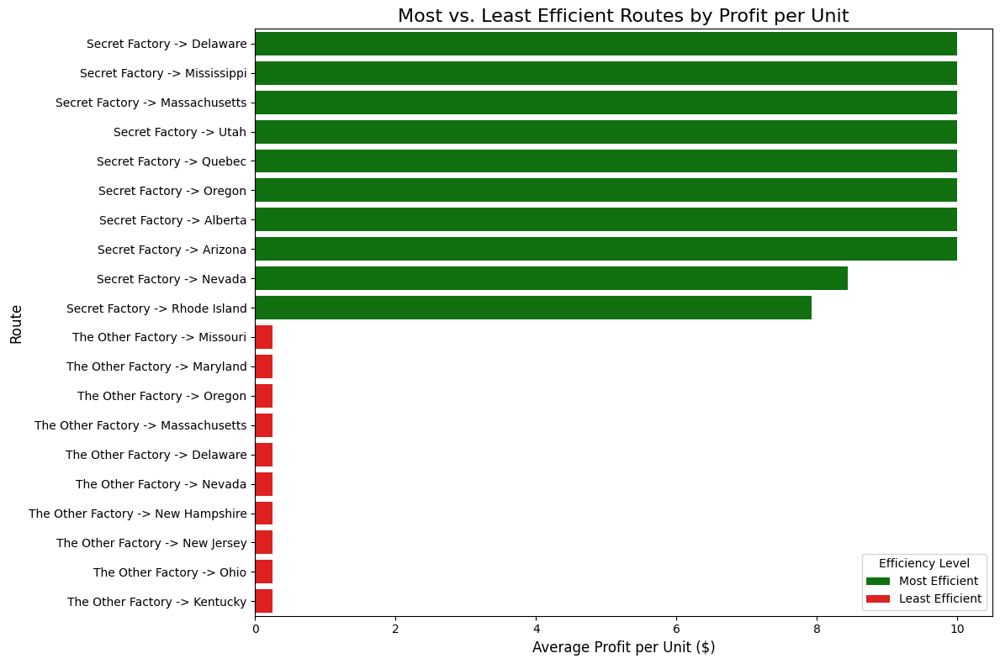

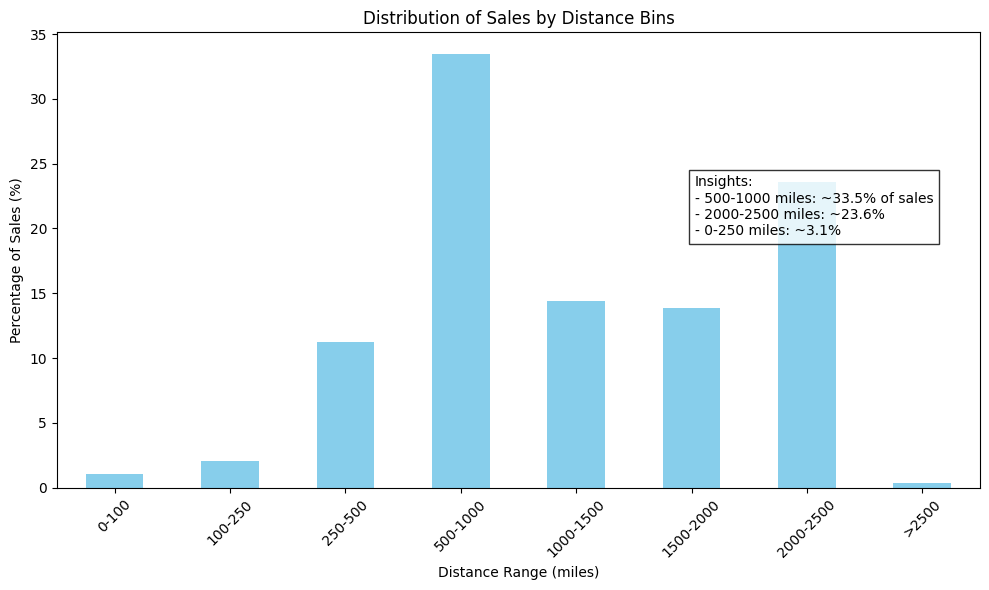

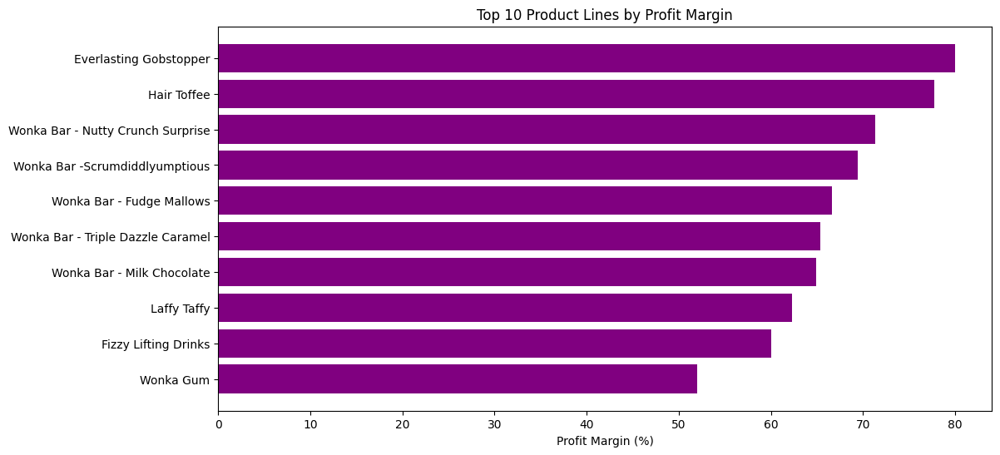

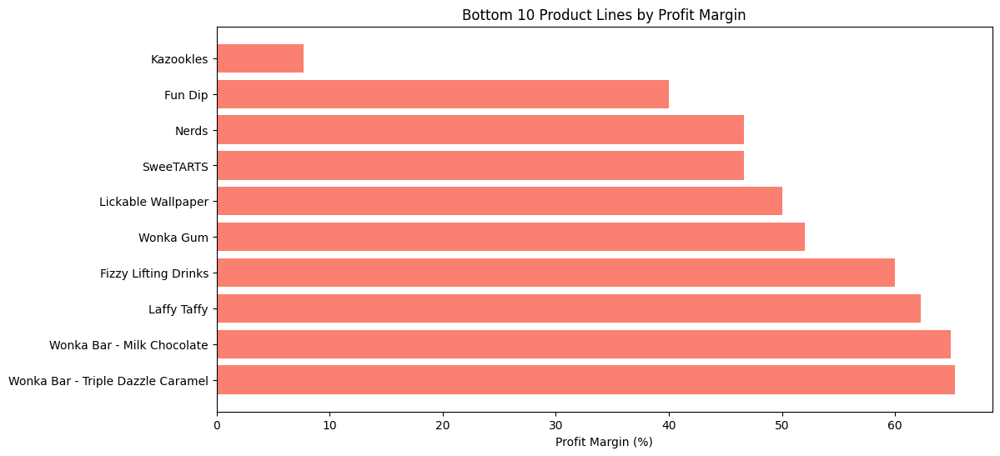

Variance in profit per unit among different products across divisions:
 Division                           Chocolate  Other  Sugar  profit_per_unit
Product Name                                                               
Lickable Wallpaper                      0.00  10.00   0.00            10.00
Everlasting Gobstopper                  0.00   0.00   8.00             8.00
Hair Toffee                             0.00   0.00   3.50             3.50
Wonka Bar -Scrumdiddlyumptious          2.50   0.00   0.00             2.50
Wonka Bar - Nutty Crunch Surprise       2.49   0.00   0.00             2.49
Wonka Bar - Triple Dazzle Caramel       2.45   0.00   0.00             2.45
Wonka Bar - Fudge Mallows               2.40   0.00   0.00             2.40
Fizzy Lifting Drinks                    0.00   0.00   2.25             2.25
Wonka Bar - Milk Chocolate              2.11   0.00   0.00             2.11
Laffy Taffy                             0.00   0.00   1.24             1.24
SweeTARTS       

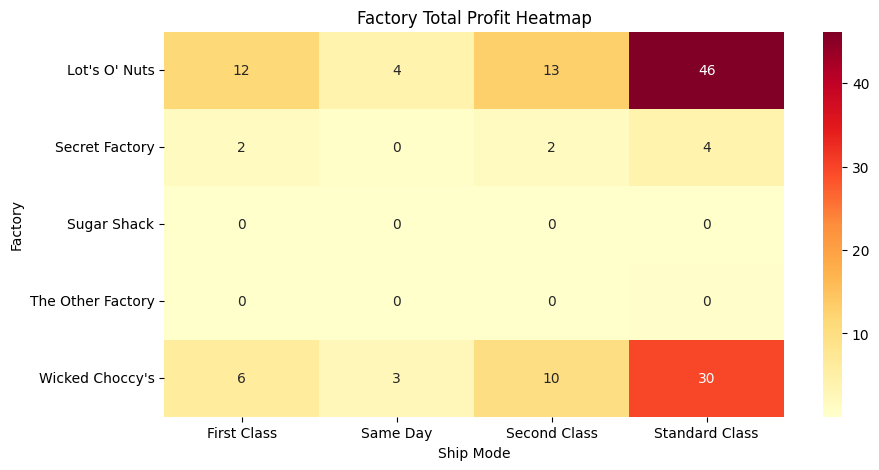

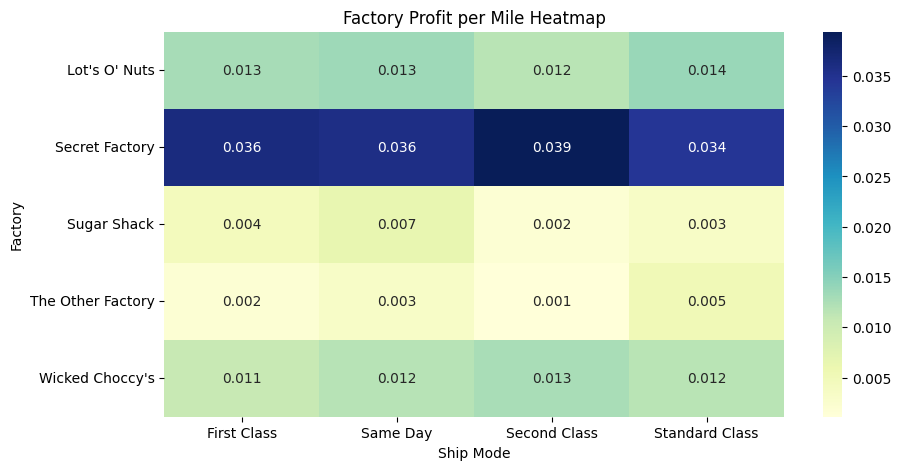

Factory Performance vs Targets:
             Factory     Sales  Target  performance_pct  met_target
1     Secret Factory   8587.50    3000            286.2        True
0      Lot's O' Nuts  76340.15   27000            282.7        True
4    Wicked Choccy's  55352.75   27000            205.0        True
3  The Other Factory   1282.25    3000             42.7       False
2        Sugar Shack    220.98   15000              1.5       False


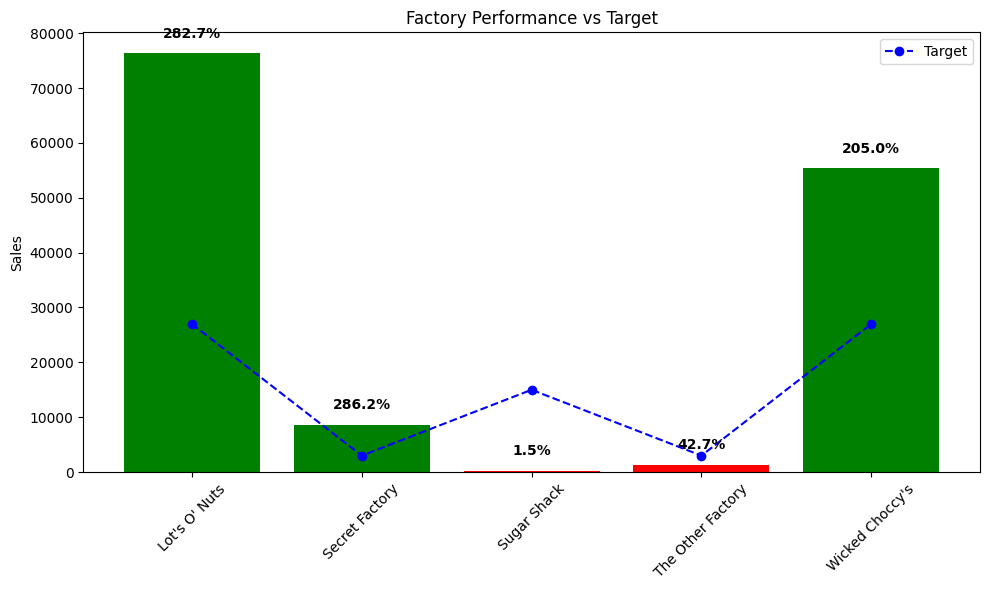

In [15]:
# --- 6. Top Shortest & Longest Routes ---
shortest_routes = sales_df.nsmallest(5, 'distance_miles')
longest_routes = sales_df.nlargest(5, 'distance_miles')
print("Top 5 Shortest Delivery Routes:\n", shortest_routes[['Order ID', 'distance_miles']])
print("\nTop 5 Longest Delivery Routes:\n", longest_routes[['Order ID', 'distance_miles']])

# --- Aggregate data by route (Factory -> State/Province) ---
route_analysis = sales_df.groupby(['Factory', 'State/Province']).agg(
    total_gross_profit=('Gross Profit', 'sum'),
    total_units=('Units', 'sum'),
    order_count=('Order ID', 'nunique')
).reset_index()

# Calculate profit per unit for each route
route_analysis['profit_per_unit'] = route_analysis['total_gross_profit'] / route_analysis['total_units']

# --- 7. Identify Most Efficient Routes ---
most_efficient_routes = route_analysis.sort_values(by='profit_per_unit', ascending=False).head(10)
print("--- Top 10 Most Efficient Shipping Routes (by Profit per Unit) ---\\n")
print(most_efficient_routes)

# --- 8. Identify Least Efficient Routes ---
least_efficient_routes = route_analysis.sort_values(by='profit_per_unit', ascending=True).head(10)
print("\\n--- Top 10 Least Efficient Shipping Routes (by Profit per Unit) ---\\n")
print(least_efficient_routes)

# --- Visualize Most Efficient and Least Efficient Routes ---

most_efficient_routes['Efficiency'] = 'Most Efficient'
least_efficient_routes['Efficiency'] = 'Least Efficient'
combined_routes = pd.concat([most_efficient_routes, least_efficient_routes])

combined_routes['route_label'] = combined_routes['Factory'] + ' -> ' + combined_routes['State/Province']
plt.figure(figsize=(12, 8))
sns.barplot(
    x='profit_per_unit',
    y='route_label',
    data=combined_routes.sort_values('profit_per_unit', ascending=False),
    hue='Efficiency',
    palette={'Most Efficient': 'green', 'Least Efficient': 'red'},
    dodge=False
)

plt.title('Most vs. Least Efficient Routes by Profit per Unit', fontsize=16)
plt.xlabel('Average Profit per Unit ($)', fontsize=12)
plt.ylabel('Route', fontsize=12)
plt.axvline(0, color='black', linewidth=0.8) # Add a line at zero
plt.legend(title='Efficiency Level')
plt.tight_layout()
plt.show()


# --- 9. Distance Binning & Visualization ---
bins = [0, 100, 250, 500, 1000, 1500, 2000, 2500]
max_distance = sales_df['distance_miles'].max()
bins.append(max(max_distance + 1, bins[-1] + 1))

labels = ['0-100','100-250','250-500','500-1000','1000-1500','1500-2000','2000-2500','>2500']
sales_df['distance_bin'] = pd.cut(sales_df['distance_miles'], bins=bins, labels=labels, right=False)

bin_counts = sales_df['distance_bin'].value_counts(normalize=True).sort_index() * 100

plt.figure(figsize=(10,6))
ax = bin_counts.plot(kind='bar', color='skyblue')
plt.title('Distribution of Sales by Distance Bins')
plt.xlabel('Distance Range (miles)')
plt.ylabel('Percentage of Sales (%)')
plt.xticks(rotation=45)

summary_text = (
    f"Insights:\n"
    f"- 500-1000 miles: ~{bin_counts.get('500-1000', 0):.1f}% of sales\n"
    f"- 2000-2500 miles: ~{bin_counts.get('2000-2500', 0):.1f}%\n"
    f"- 0-250 miles: ~{(bin_counts.get('0-100', 0) + bin_counts.get('100-250', 0)):.1f}%"
)
plt.gcf().text(0.7, 0.6, summary_text, fontsize=10, bbox=dict(facecolor='white', alpha=0.8))
plt.tight_layout()
plt.show()

# --- 10. Most Profitable Product Lines ---
product_margin = sales_df.groupby('Product Name').agg(
    total_profit=('Gross Profit','sum'),
    total_sales=('Sales','sum')
).reset_index()
product_margin['profit_margin_pct'] = product_margin['total_profit'] / product_margin['total_sales'] * 100
top_margin_products = product_margin.sort_values('profit_margin_pct', ascending=False).head(10)

plt.figure(figsize=(12,6))
plt.barh(top_margin_products['Product Name'], top_margin_products['profit_margin_pct'], color='purple')
plt.xlabel('Profit Margin (%)')
plt.title('Top 10 Product Lines by Profit Margin')
plt.gca().invert_yaxis()
plt.show()


# --- 11. Least Profitable Product Lines ---
least_margin_products = product_margin.sort_values('profit_margin_pct', ascending=True).head(10)

plt.figure(figsize=(12,6))
plt.barh(least_margin_products['Product Name'], least_margin_products['profit_margin_pct'], color='salmon')
plt.xlabel('Profit Margin (%)')
plt.title('Bottom 10 Product Lines by Profit Margin')
plt.gca().invert_yaxis()
plt.show()


# --- 12. Product vs Division Profitability Analysis ---

product_div_profit = sales_df.groupby(['Product Name','Division']).agg(
    total_units=('Units','sum'),
    total_profit=('Gross Profit','sum')
).reset_index()
product_div_profit['profit_per_unit'] = product_div_profit['total_profit'] / product_div_profit['total_units']

# Pivot to compare products
pivot = product_div_profit.pivot(index='Product Name', columns='Division', values='profit_per_unit').fillna(0)

# The max-min calculation simply isolates the single non-zero profit_per_unit value for each product
pivot['profit_per_unit'] = pivot.max(axis=1) - pivot.min(axis=1)

# Sort by the corrected column name to find top performers
products_to_consider = pivot.sort_values('profit_per_unit', ascending=False).head(15)

print("Variance in profit per unit among different products across divisions:\n", products_to_consider)

# --- 13. Factory Shipping Efficiency Analysis ---
factory_shipmode_summary = sales_df.groupby(['Factory','Ship Mode']).agg(
    avg_distance_miles=('distance_miles','mean'),
    avg_cost_per_mile=('cost_per_mile','mean'),
    avg_profit_per_mile=('profit_per_mile','mean'),
    total_profit=('profit_per_mile','sum'),  # <-- Added for total profit
    delivery_count=('Order ID','count')
).reset_index().round({
    'avg_distance_miles': 2,
    'avg_cost_per_mile': 4,
    'avg_profit_per_mile': 4,
    'total_profit': 2
})

# ---- Scatter Plot ----
fig = px.scatter(
    factory_shipmode_summary,
    x='avg_distance_miles',
    y='avg_profit_per_mile',
    size='delivery_count',
    color='Ship Mode',
    hover_name='Factory',
    custom_data=['avg_cost_per_mile', 'total_profit'],
    title='Factory Shipping Efficiency by Ship Mode',
    size_max=40, width=1200, height=600
)
fig.update_traces(
    hovertemplate="<b>%{hovertext}</b><br>"
                  "Avg Distance: %{x:.2f} miles<br>"
                  "Avg Profit/Mile: %{y:.4f} $<br>"
                  "Avg Cost/Mile: %{customdata[0]:.4f} $<br>"
                  "Total Profit: %{customdata[1]:,.2f} $<br>"
                  "Delivery Count: %{marker.size:.0f}"
)
fig.show()

# ---- Heatmap 1: Total Profit ----
profit_matrix = factory_shipmode_summary.pivot(
    index='Factory',
    columns='Ship Mode',
    values='total_profit'
).fillna(0)

plt.figure(figsize=(10, 5))
sns.heatmap(profit_matrix, annot=True, fmt=".0f", cmap='YlOrRd')
plt.title('Factory Total Profit Heatmap')
plt.show()

# ---- Heatmap 2: Profit per Mile ----
ppm_matrix = factory_shipmode_summary.pivot(
    index='Factory',
    columns='Ship Mode',
    values='avg_profit_per_mile'
).fillna(0)

plt.figure(figsize=(10, 5))
sns.heatmap(ppm_matrix, annot=True, fmt=".3f", cmap='YlGnBu')
plt.title('Factory Profit per Mile Heatmap')
plt.show()

# --- 14. Factory Performance vs Target ---

# 1. Aggregate total sales per factory
factory_sales = sales_df.groupby("Factory", as_index=False)["Sales"].sum()

# 2. Get target per factory (assuming first value per factory is representative)
factory_targets = sales_df.groupby("Factory", as_index=False)["Target"].first()

# 3. Merge actual sales and targets
factory_perf = factory_sales.merge(factory_targets, on="Factory")

# 4. Compute percent achievement of target (rounded to 1 decimal)
factory_perf["performance_pct"] = round((factory_perf["Sales"] / factory_perf["Target"]) * 100,1)

# 5. Flag factories that met or exceeded target
factory_perf["met_target"] = factory_perf["performance_pct"] >= 100

# Display factory-level performance
print("Factory Performance vs Targets:")
print(factory_perf.sort_values("performance_pct", ascending=False))

# ===============================
#  Visualization
# ===============================
plt.figure(figsize=(10,6))

bars = plt.bar(factory_perf["Factory"], factory_perf["Sales"],
               color=factory_perf["met_target"].map({True:"green", False:"red"}))
plt.plot(factory_perf["Factory"], factory_perf["Target"],
         color="blue", marker="o", linestyle="--", label="Target")

# Annotate with % achievement (fixed offset)
for bar, pct in zip(bars, factory_perf["performance_pct"]):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, height + (0.03 * max(factory_perf["Sales"])),
             f"{pct}%", ha="center", va="bottom",
             fontsize=10, fontweight="bold")

plt.title("Factory Performance vs Target")
plt.ylabel("Sales")
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()



In [16]:
# --- 15. Factory Performance vs Target ---

# 1. Aggregate total sales per factory
factory_sales = sales_df.groupby("Factory", as_index=False)["Sales"].sum()

# 2. Get target per factory (assuming first value per factory is representative)
factory_targets = sales_df.groupby("Factory", as_index=False)["Target"].first()

# 3. Merge actual sales and targets
factory_perf = factory_sales.merge(factory_targets, on="Factory")

# 4. Compute percent achievement of target (rounded to 1 decimal)
factory_perf["performance_pct"] = round((factory_perf["Sales"] / factory_perf["Target"]) * 100, 1)

# 5. Flag factories that met or exceeded target
factory_perf["met_target"] = factory_perf["performance_pct"] >= 100

# --- Add totals row ---
total_sales = factory_perf["Sales"].sum()
total_target = factory_perf["Target"].sum()
total_perf_pct = round((total_sales / total_target) * 100, 1)

totals_row = pd.DataFrame({
    "Factory": ["TOTAL"],
    "Sales": [total_sales],
    "Target": [total_target],
    "performance_pct": [total_perf_pct],
    "met_target": [total_perf_pct >= 100]
})

factory_perf = pd.concat([factory_perf, totals_row], ignore_index=True)

# --- Format for nice display ---
factory_perf["Sales"] = factory_perf["Sales"].map("{:,.0f}".format)
factory_perf["Target"] = factory_perf["Target"].map("{:,.0f}".format)
factory_perf["performance_pct"] = factory_perf["performance_pct"].map("{:.1f}%".format)

print("Factory Performance vs Targets:\n")
print(factory_perf.sort_values("performance_pct", ascending=False).to_string(index=False))



Factory Performance vs Targets:

          Factory   Sales Target performance_pct  met_target
The Other Factory   1,282  3,000           42.7%       False
   Secret Factory   8,588  3,000          286.2%        True
    Lot's O' Nuts  76,340 27,000          282.7%        True
  Wicked Choccy's  55,353 27,000          205.0%        True
            TOTAL 141,784 75,000          189.0%        True
      Sugar Shack     221 15,000            1.5%       False


In [17]:
print(sales_df.columns)

Index(['Row ID', 'Order ID', 'Order Date', 'Ship Date', 'Ship Mode',
       'Customer ID', 'Country/Region', 'city', 'State/Province',
       'postal_code', 'Division', 'Region', 'Product ID', 'Product Name',
       'Sales', 'Units', 'Gross Profit', 'Cost', 'lat_customer',
       'lng_customer', 'Factory', 'lat_factory', 'lng_factory', 'Target',
       'distance_miles', 'cost_per_mile', 'profit_per_mile', 'profit_per_unit',
       'days_to_ship', 'distance_bin'],
      dtype='object')


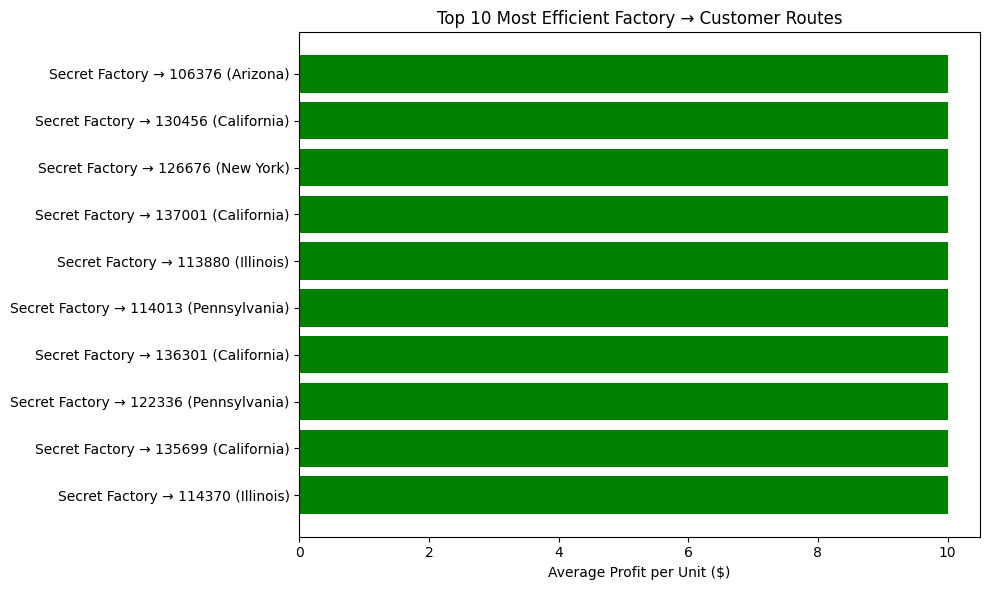

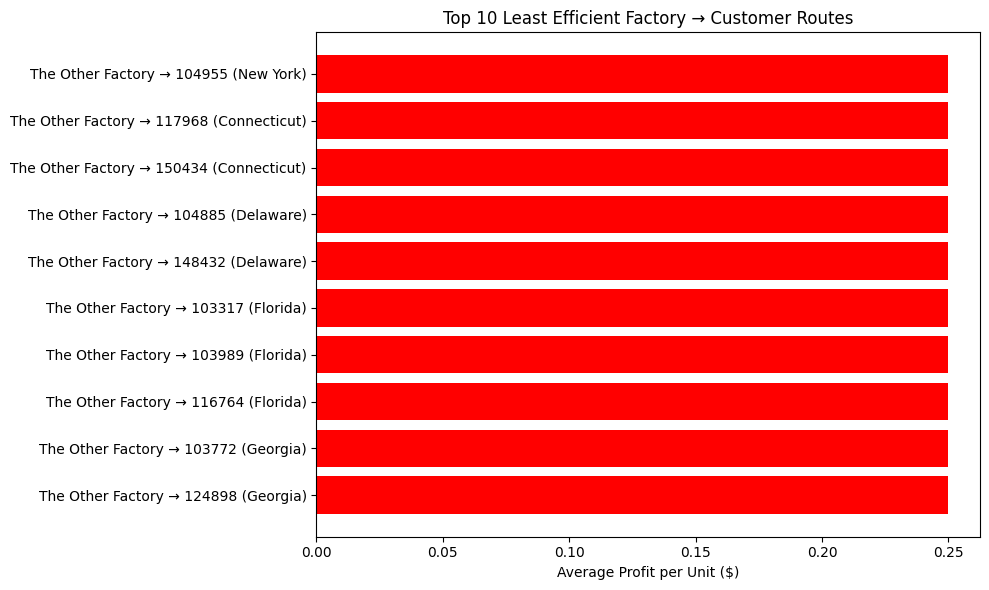

In [18]:
# --- 16. Route Efficiency Analysis (Factory → Customer with State) ---

# Calculate profit per unit 
sales_df['profit_per_unit'] = sales_df['Gross Profit'] / sales_df['Units']

# Aggregate by Factory → Customer → State
route_efficiency = sales_df.groupby(
    ['Factory', 'Country/Region', 'State/Province', 'Customer ID']
).agg(
    total_units=('Units', 'sum'),
    total_profit=('Gross Profit', 'sum'),
    total_cost=('Cost', 'sum'),
    avg_profit_per_unit=('profit_per_unit', 'mean'),
    profit_margin=('Gross Profit', lambda x: x.sum() / sales_df.loc[x.index, 'Cost'].sum())
).reset_index()

# Build readable route label
route_efficiency['route_label'] = (
    route_efficiency['Factory'] + " → " +
    route_efficiency['Customer ID'].astype(str) + " (" +
    route_efficiency['State/Province'] + ")"
)

# Top 10 most and least efficient routes
most_efficient_routes = route_efficiency.sort_values('avg_profit_per_unit', ascending=False).head(10)
least_efficient_routes = route_efficiency.sort_values('avg_profit_per_unit').head(10)

# Plot Top 10 most efficient routes
plt.figure(figsize=(10,6))
plt.barh(
    most_efficient_routes['route_label'],
    most_efficient_routes['avg_profit_per_unit'],
    color='green'
)
plt.xlabel('Average Profit per Unit ($)')
plt.title('Top 10 Most Efficient Factory → Customer Routes')
plt.gca().invert_yaxis()
plt.tight_layout()
plt.show()

# Plot Top 10 least efficient routes
plt.figure(figsize=(10,6))
plt.barh(
    least_efficient_routes['route_label'],
    least_efficient_routes['avg_profit_per_unit'],
    color='red'
)
plt.xlabel('Average Profit per Unit ($)')
plt.title('Top 10 Least Efficient Factory → Customer Routes')
plt.gca().invert_yaxis()
plt.tight_layout()
plt.show()




## 6. What if Scenario Analysis

In [19]:
# ===============================================================
# STEP 6: Route Optimization Analysis
# ===============================================================
# --- Calculate Distance to ALL Factories for Each Order ---
cust_lats = sales_df['lat_customer'].values[:, np.newaxis]
cust_lngs = sales_df['lng_customer'].values[:, np.newaxis]
fact_lats = factories['Latitude'].values[np.newaxis, :]
fact_lngs = factories['Longitude'].values[np.newaxis, :]

dist_matrix = haversine_vectorized(cust_lats, cust_lngs, fact_lats, fact_lngs)
nearest_factory_idx = dist_matrix.argmin(axis=1)

# --- Identify the Nearest Factory and Distance ---
sales_df['nearest_factory'] = factories.loc[nearest_factory_idx, 'Factory'].values
sales_df['nearest_distance'] = dist_matrix[np.arange(len(sales_df)), nearest_factory_idx]
sales_df['distance_saved'] = sales_df['distance_miles'] - sales_df['nearest_distance']

# ===============================================================
# STEP 6.1 AGGREGATE TO UNIQUE ORDER (CONSOLIDATED)
# ===============================================================

# Single, comprehensive aggregation for each order
order_summary = sales_df.groupby('Order ID').agg(
    # --- Numeric Aggregations ---
    Sales=('Sales', 'sum'),
    total_gross_profit=('Gross Profit', 'sum'),
    total_cost=('Cost', 'sum'),
    total_current_distance=('distance_miles', 'sum'),
    total_nearest_distance=('nearest_distance', 'sum'),
    
    # --- Categorical "Aggregations" (using 'first') ---
    Factory=('Factory', 'first'),
    nearest_factory=('nearest_factory', 'first'),
    Division=('Division', 'first'),
    Region=('Region', 'first'),
    State_Province=('State/Province', 'first'), 
    Ship_Mode=('Ship Mode', 'first'),
    lat_customer=('lat_customer', 'first'),
    lng_customer=('lng_customer', 'first')
).reset_index()


# Calculate potential savings and uplift
order_summary['distance_saved'] = order_summary['total_current_distance'] - order_summary['total_nearest_distance']
order_summary['cost_per_mile'] = order_summary['total_cost'] / order_summary['total_current_distance']
order_summary['profit_per_mile'] = order_summary['total_gross_profit'] / order_summary['total_current_distance']
order_summary['profit_uplift'] = order_summary['distance_saved'] * order_summary['profit_per_mile']
order_summary['delivery_savings'] = order_summary['distance_saved'] * order_summary['cost_per_mile']

# Decide which orders should switch
order_summary['should_switch_factory'] = (
    (order_summary['profit_uplift'] > 0) & (order_summary['distance_saved'] > 0)
)

# --- Push order-level metrics back to sales_df for product-level analysis ---
sales_df = sales_df.merge(
    order_summary[['Order ID', 'profit_uplift', 'delivery_savings', 'distance_saved', 'should_switch_factory']],
    on='Order ID',
    how='left'
)
# Keep only order-level distance_saved
sales_df = sales_df.drop(columns=['distance_saved_x']).rename(columns={'distance_saved_y': 'distance_saved'})


# Save conservative order-level results (pre-model)
premodel_path = "/Users/debbiego/Desktop/Myfolder/Capstone/data/sales_premodel_orderlevel.csv"
order_summary.to_csv(premodel_path, index=False)
print(f"Preliminary pre-model file saved here: {premodel_path}")


# ===============================================================
# STEP 6.2 ANALYSIS OF OPTIMIZATION RESULTS
# ===============================================================
# --- A. High-Level Financial Impact Summary ---
eligible_orders = order_summary[order_summary['should_switch_factory']]

# Calculate the true totals
total_profit_uplift = eligible_orders['profit_uplift'].sum()
total_distance_saved = eligible_orders['distance_saved'].sum()
total_delivery_savings = eligible_orders['delivery_savings'].sum()

print("\n--- Total Potential Impact from Route Optimization ---")
print(f"Total Unique Orders to Switch: {len(eligible_orders):,}")
print(f"Estimated Total Profit Uplift: ${total_profit_uplift:,.2f}")
print(f"Estimated Total Delivery Savings: ${total_delivery_savings:,.2f}")
print(f"Total Distance Saved: {total_distance_saved:,.0f} miles")


Preliminary pre-model file saved here: /Users/debbiego/Desktop/Myfolder/Capstone/data/sales_premodel_orderlevel.csv

--- Total Potential Impact from Route Optimization ---
Total Unique Orders to Switch: 5,850
Estimated Total Profit Uplift: $42,704.39
Estimated Total Delivery Savings: $21,629.38
Total Distance Saved: 7,548,037 miles


In [20]:
# --- B. Profit Opportunity per Order (by Range) ---

#  Make a safe copy to avoid SettingWithCopyWarning
eligible_orders = order_summary[order_summary['should_switch_factory']].copy()

#  Define uplift bins
bins = [-float("inf"), 0, 10, 50, 100, 500, float("inf")]
labels = ["<=0", "0-10", "10-50", "50-100", "100-500", "500+"]

eligible_orders['uplift_bin'] = pd.cut(
    eligible_orders['profit_uplift'], 
    bins=bins, 
    labels=labels
)

#  Aggregate by bin (orders, profit uplift, miles saved)
segmented = (
    eligible_orders
    .groupby('uplift_bin', observed=True)
    .agg(
        total_orders=('Order ID', 'count'),
        total_profit_uplift=('profit_uplift', 'sum'),
        total_miles_saved=('distance_saved', 'sum')
    )
    .reset_index()
)

# --- Format values for readability ---
segmented_fmt = segmented.copy()
segmented_fmt['total_orders'] = segmented_fmt['total_orders'].apply(lambda x: f"{x:,.0f}")
segmented_fmt['total_profit_uplift'] = segmented_fmt['total_profit_uplift'].apply(lambda x: f"${x:,.0f}")
segmented_fmt['total_miles_saved'] = segmented_fmt['total_miles_saved'].apply(lambda x: f"{x:,.0f}")

# --- Print segmentation table ---
print("\n--- Impact Segmented by Profit Uplift per Order ---")
print(segmented_fmt.to_string(index=False))




--- Impact Segmented by Profit Uplift per Order ---
uplift_bin total_orders total_profit_uplift total_miles_saved
      0-10        4,483             $21,261         4,853,618
     10-50        1,360             $20,994         2,686,451
    50-100            7                $450             7,968


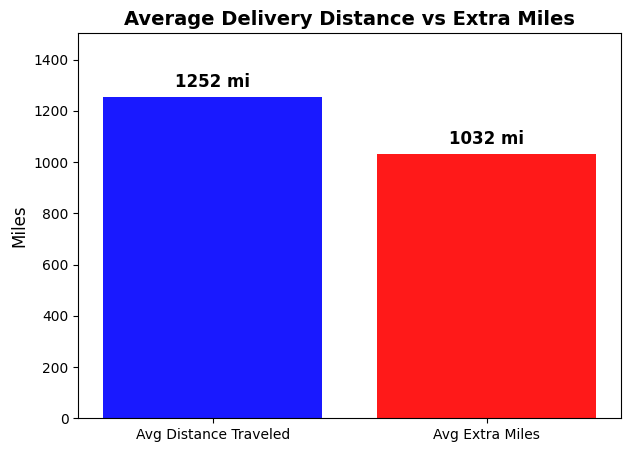

In [21]:
# --- Calculate averages ---
avg_distance = sales_df["distance_miles"].mean()
avg_extra = sales_df["distance_saved"].mean()

values = [avg_distance, avg_extra]
labels = ["Avg Distance Traveled", "Avg Extra Miles"]
colors = ["blue", "red"]

# --- Plot ---
plt.figure(figsize=(7,5))
bars = plt.bar(labels, values, color=colors, alpha=0.9)

# Add labels on top
for bar, val in zip(bars, values):
    plt.text(bar.get_x() + bar.get_width()/2, val + (0.02*max(values)),
             f"{val:.0f} mi", ha="center", va="bottom", fontsize=12, fontweight="bold")

# Titles and labels
plt.title("Average Delivery Distance vs Extra Miles", fontsize=14, fontweight="bold")
plt.ylabel("Miles", fontsize=12)
plt.ylim(0, max(values)*1.2)

plt.show()


In [22]:
# --- C. Top Re-Routing Opportunities by Route ---
# Group by the switch from the current factory to the nearest one
impact_by_switch_route = eligible_orders.groupby(['Factory', 'Region','nearest_factory']).agg(
    total_profit_uplift=('profit_uplift', 'sum'),
    num_affected_orders=('Order ID', 'nunique')
).reset_index().sort_values(by='total_profit_uplift', ascending=False)

# Format total_profit_uplift for readability
impact_by_switch_route['total_profit_uplift'] = impact_by_switch_route['total_profit_uplift'].map('${:,.0f}'.format)

print("--- Top 10 Most Profitable Factory Re-Routing Opportunities ---")
display(impact_by_switch_route.head(10))


--- Top 10 Most Profitable Factory Re-Routing Opportunities ---


,Factory,Region,nearest_factory,total_profit_uplift,num_affected_orders
38,Wicked Choccy's,Pacific,Lot's O' Nuts,"$8,669",1098
2,Lot's O' Nuts,Atlantic,Wicked Choccy's,"$7,941",1063
6,Lot's O' Nuts,Interior,Secret Factory,"$5,064",547
5,Lot's O' Nuts,Gulf,Wicked Choccy's,"$4,797",517
35,Wicked Choccy's,Interior,Secret Factory,"$2,936",414
8,Lot's O' Nuts,Interior,The Other Factory,"$2,737",512
0,Lot's O' Nuts,Atlantic,Secret Factory,"$2,273",291
4,Lot's O' Nuts,Gulf,The Other Factory,"$2,081",222
37,Wicked Choccy's,Interior,The Other Factory,"$1,701",350
33,Wicked Choccy's,Gulf,The Other Factory,"$1,007",156


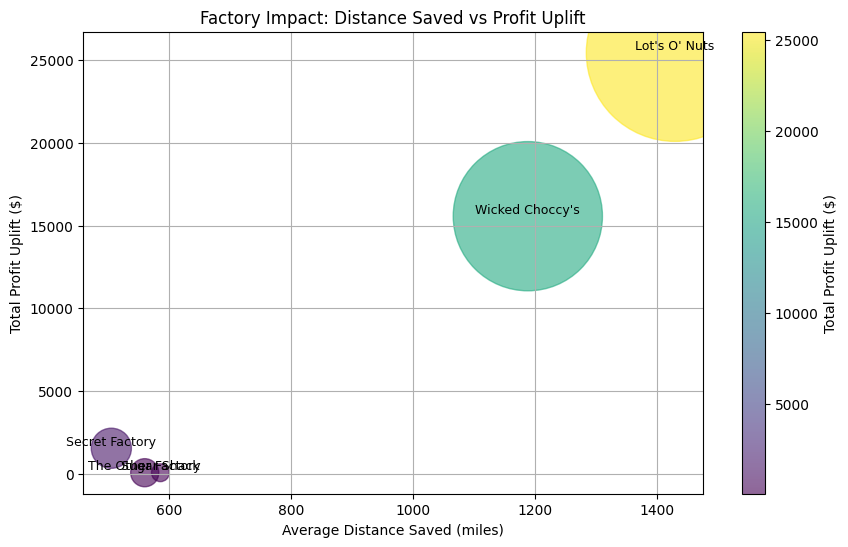

In [23]:
# --- D. Visualize Factory-Level Impact ---

# Use order_summary (has should_switch_factory info)
factory_summary = (
    order_summary[order_summary['should_switch_factory']]
    .groupby('Factory')
    .agg(
        avg_distance_saved=('distance_saved', 'mean'),
        total_profit_uplift=('profit_uplift', 'sum'),
        customers_switching=('Order ID', 'count')
    )
    .reset_index()
)

plt.figure(figsize=(10,6))
scatter = plt.scatter(
    x=factory_summary['avg_distance_saved'],
    y=factory_summary['total_profit_uplift'],
    s=factory_summary['customers_switching']*5,  # scale bubble size
    alpha=0.6,
    c=factory_summary['total_profit_uplift'],    # color intensity by total profit
    cmap='viridis'
)

# Add factory labels
for i, row in factory_summary.iterrows():
    plt.text(
        row['avg_distance_saved'],
        row['total_profit_uplift'],
        row['Factory'],
        fontsize=9,
        ha='center',
        va='bottom'
    )

# Labels & title
plt.xlabel('Average Distance Saved (miles)')
plt.ylabel('Total Profit Uplift ($)')
plt.title('Factory Impact: Distance Saved vs Profit Uplift')
plt.colorbar(scatter, label='Total Profit Uplift ($)')
plt.grid(True)
plt.show()


In [24]:
# --- E. Analysis of Efficient (Non-Switching) Routes ---
# Filter for orders that DO NOT need to switch
efficient_orders = order_summary[~order_summary['should_switch_factory']]

# Analyze which factory-region pairs are already efficient
efficient_routes_summary = efficient_orders.groupby(['Factory', 'Region']).agg(
    num_orders=('Order ID', 'nunique')
).reset_index().sort_values(by='num_orders', ascending=False)

print("--- Most Efficient Existing Factory-Region Assignments (No Switch Needed) ---")
display(efficient_routes_summary.head(10))

--- Most Efficient Existing Factory-Region Assignments (No Switch Needed) ---


,Factory,Region,num_orders
1,Lot's O' Nuts,Pacific,1482
6,Wicked Choccy's,Atlantic,747
7,Wicked Choccy's,Gulf,389
3,Secret Factory,Interior,29
0,Lot's O' Nuts,Interior,19
2,Secret Factory,Atlantic,17
5,The Other Factory,Interior,9
4,The Other Factory,Gulf,7


In [25]:
print(order_summary.columns)

Index(['Order ID', 'Sales', 'total_gross_profit', 'total_cost',
       'total_current_distance', 'total_nearest_distance', 'Factory',
       'nearest_factory', 'Division', 'Region', 'State_Province', 'Ship_Mode',
       'lat_customer', 'lng_customer', 'distance_saved', 'cost_per_mile',
       'profit_per_mile', 'profit_uplift', 'delivery_savings',
       'should_switch_factory'],
      dtype='object')


Impact Analysis by Ship Mode (unique orders):
should_switch_factory  False  True 
Ship_Mode                          
First Class              437    875
Same Day                 148    294
Second Class             516   1137
Standard Class          1598   3544

Profit Contribution by Ship Mode (switched orders only):
        Ship_Mode avg_profit_uplift total_profit_uplift
0     First Class             $7.18              $6,284
1        Same Day             $7.11              $2,090
2    Second Class             $7.43              $8,444
3  Standard Class             $7.30             $25,887


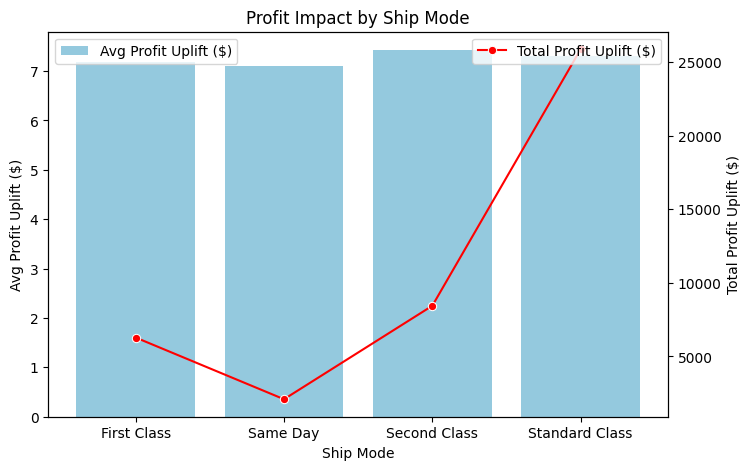

In [26]:
# --- F. Impact + Profit Analysis by Ship Mode ---

# 1) Impact analysis: unique-order counts
shipmode_switch_counts = (
    order_summary
    .groupby(['Ship_Mode', 'should_switch_factory'])['Order ID']
    .nunique()
    .unstack(fill_value=0)
)
print("Impact Analysis by Ship Mode (unique orders):")
print(shipmode_switch_counts)

# 2) Profit contribution (switched orders only, without redundant order counts)
profit_by_shipmode = (
    order_summary[order_summary['should_switch_factory'] == True]
    .groupby('Ship_Mode')
    .agg(
        avg_profit_uplift=('profit_uplift', 'mean'),
        total_profit_uplift=('profit_uplift', 'sum')
    )
    .reset_index()
)

# Format profit columns for readability
profit_by_shipmode['total_profit_uplift'] = profit_by_shipmode['total_profit_uplift'].map('${:,.0f}'.format)
profit_by_shipmode['avg_profit_uplift'] = profit_by_shipmode['avg_profit_uplift'].map('${:,.2f}'.format)

print("\nProfit Contribution by Ship Mode (switched orders only):")
print(profit_by_shipmode)

# 3) Visualization
fig, ax1 = plt.subplots(figsize=(8,5))

# Bar: Avg Profit Uplift
sns.barplot(
    x='Ship_Mode', y='avg_profit_uplift',
    data=order_summary[order_summary['should_switch_factory']]
         .groupby('Ship_Mode')
         .agg(avg_profit_uplift=('profit_uplift','mean'))
         .reset_index(),
    ax=ax1, color='skyblue', label='Avg Profit Uplift ($)'
)
ax1.set_ylabel('Avg Profit Uplift ($)')
ax1.set_xlabel('Ship Mode')
ax1.set_title('Profit Impact by Ship Mode')

# Line: Total Profit Uplift
ax2 = ax1.twinx()
sns.lineplot(
    x='Ship_Mode', y='total_profit_uplift',
    data=order_summary[order_summary['should_switch_factory']]
         .groupby('Ship_Mode')
         .agg(total_profit_uplift=('profit_uplift','sum'))
         .reset_index(),
    ax=ax2, color='red', marker='o', label='Total Profit Uplift ($)'
)
ax2.set_ylabel('Total Profit Uplift ($)')

# Legends
ax1.legend(loc='upper left')
ax2.legend(loc='upper right')

plt.show()


In [27]:
# --- G. Impact Analysis by State ---
state_summary = (
    order_summary.groupby('State_Province')
    .agg({
        'Sales': 'sum',
        'profit_uplift': 'sum',
        'Order ID': pd.Series.nunique,
        'should_switch_factory': 'sum'
    })
    .rename(columns={
        'Sales': 'total_sales',
        'profit_uplift': 'total_profit_uplift',
        'Order ID': 'num_orders',
        'should_switch_factory': 'num_orders_to_switch'
    })
    .reset_index()
)

# Add percentages
state_summary['pct_orders_to_switch'] = (
    state_summary['num_orders_to_switch'] / state_summary['num_orders'] * 100
).round(1)

# Sort by uplift
state_summary = state_summary.sort_values(by='total_profit_uplift', ascending=False)

# Format monetary columns
state_summary['total_profit_uplift'] = (
    state_summary['total_profit_uplift'].round(0).astype(int).map("${:,}".format)
)
state_summary['total_sales'] = (
    state_summary['total_sales'].round(0).astype(int).map("${:,}".format)
)

print("\n Impact Analysis by State (Top 10 States by Profit Uplift)")
display(state_summary.head(10))


# --- H. Impact Analysis by Region ---
region_summary = (
    order_summary.groupby('Region')
    .agg({
        'Sales': 'sum',
        'profit_uplift': 'sum',
        'Order ID': pd.Series.nunique,
        'should_switch_factory': 'sum'
    })
    .rename(columns={
        'Sales': 'total_sales',
        'profit_uplift': 'total_profit_uplift',
        'Order ID': 'num_orders',
        'should_switch_factory': 'num_orders_to_switch'
    })
    .reset_index()
)

# Add percentages
region_summary['pct_orders_to_switch'] = (
    region_summary['num_orders_to_switch'] / region_summary['num_orders'] * 100
).round(1)

# Sort by uplift
region_summary = region_summary.sort_values(by='total_profit_uplift', ascending=False)

# Format monetary columns
region_summary['total_profit_uplift'] = (
    region_summary['total_profit_uplift'].round(0).astype(int).map("${:,}".format)
)
region_summary['total_sales'] = (
    region_summary['total_sales'].round(0).astype(int).map("${:,}".format)
)

print("\n Impact Analysis by Region")
display(region_summary)


# --- I. Impact Analysis by Product ---
switch_candidates = order_summary[order_summary['should_switch_factory']]

tmp = sales_df[sales_df['Order ID'].isin(switch_candidates['Order ID'])].copy()

# Make sure numeric fields exist
for col in ['profit_uplift', 'delivery_savings', 'distance_saved']:
    tmp[col] = pd.to_numeric(tmp[col], errors='coerce').fillna(0)

product_uplift_summary = (
    tmp.groupby('Product Name')
       .agg({
           'profit_uplift': 'sum',
           'delivery_savings': 'sum',
           'Units': 'sum',
           'distance_saved': 'mean',
           'Order ID': pd.Series.nunique
       })
       .rename(columns={
           'profit_uplift': 'total_profit_uplift',
           'delivery_savings': 'total_delivery_savings',
           'Units': 'total_units',
           'distance_saved': 'avg_distance_saved',
           'Order ID': 'num_affected_orders'
       })
       .sort_values(by='total_profit_uplift', ascending=False)
)

# Format monetary columns
product_uplift_summary['total_profit_uplift'] = product_uplift_summary['total_profit_uplift'].map('${:,.0f}'.format)
product_uplift_summary['total_delivery_savings'] = product_uplift_summary['total_delivery_savings'].map('${:,.0f}'.format)

# Round others
product_uplift_summary = product_uplift_summary.round({
    'avg_distance_saved': 1,
    'total_units': 0,
    'num_affected_orders': 0
})

print("\n Impact Analysis by Product (Top 10 Products by Profit Uplift)")
display(product_uplift_summary.head(10))



 Impact Analysis by State (Top 10 States by Profit Uplift)


,State_Province,total_sales,total_profit_uplift,num_orders,num_orders_to_switch,pct_orders_to_switch
5,California,"$27,917","$6,263",1686,742,44.0
34,New York,"$15,541","$4,148",942,616,65.4
51,Texas,"$13,416","$4,008",833,806,96.8
13,Illinois,"$6,899","$3,700",433,420,97.0
39,Ohio,"$6,769","$2,310",392,380,96.9
43,Pennsylvania,"$8,027","$2,163",487,299,61.4
10,Florida,"$4,804","$1,570",319,188,58.9
23,Michigan,"$3,331","$1,499",209,204,97.6
2,Arizona,"$3,588","$1,238",190,96,50.5
36,North Carolina,"$3,451","$1,231",216,125,57.9



 Impact Analysis by Region


,Region,total_sales,total_profit_uplift,num_orders,num_orders_to_switch,pct_orders_to_switch
2,Interior,"$32,038","$13,248",1979,1922,97.1
0,Atlantic,"$41,197","$11,260",2476,1712,69.1
3,Pacific,"$46,302","$9,934",2744,1262,46.0
1,Gulf,"$22,247","$8,262",1350,954,70.7



 Impact Analysis by Product (Top 10 Products by Profit Uplift)


,total_profit_uplift,total_delivery_savings,total_units,avg_distance_saved,num_affected_orders
Product Name,,,,,
Wonka Bar -Scrumdiddlyumptious,"$13,281","$5,844",5313,1709.1,1150
Wonka Bar - Nutty Crunch Surprise,"$11,363","$4,563",4671,1651.6,1051
Wonka Bar - Triple Dazzle Caramel,"$11,226","$5,957",5169,1370.5,1135
Wonka Bar - Fudge Mallows,"$11,028","$5,514",4725,1672.2,1058
Wonka Bar - Milk Chocolate,"$10,483","$5,664",5562,1372.8,1174
Lickable Wallpaper,"$1,468","$1,468",297,542.6,71
Wonka Gum,$113,$104,375,494.1,93
Everlasting Gobstopper,$48,$12,13,399.8,3
Hair Toffee,$39,$11,17,746.2,4


In [28]:
# ==============================================================================
# STEP 6.3 INTERACTIVE MAP VISUALIZATION
# ==============================================================================
# This section creates a detailed, interactive map to visualize the results of the
# what-if scenario analysis.

# Set the map's center and initial zoom level
map_center = [order_summary['lat_customer'].mean(), order_summary['lng_customer'].mean()]
m = folium.Map(location=map_center, zoom_start=6, tiles="OpenStreetMap")

# --- Layer 1: Factory Locations (Blue Markers) ---
for _, row in factories.iterrows():
    folium.Marker(
        location=[row['Latitude'], row['Longitude']],
        popup=f"Factory: {row['Factory']}",
        icon=folium.Icon(color='blue', icon='industry', prefix='fa')
    ).add_to(m)

# --- Layer 2: Efficient Orders to Keep (Green Markers) ---
keep_layer = folium.FeatureGroup(name='Keep Current Factory')
for _, row in order_summary[~order_summary['should_switch_factory']].iterrows():
    popup_text = (f"<b>Order ID:</b> {row['Order ID']}<br>"
                  f"Current Factory: {row['Factory']}<br>"
                  f"Nearest is '{row['nearest_factory']}' but switching is not more profitable.")
    folium.CircleMarker(
        location=[row['lat_customer'], row['lng_customer']], radius=4, color='green',
        fill=True, fill_color='green', fill_opacity=0.7,
        popup=folium.Popup(popup_text, max_width=300)
    ).add_to(keep_layer)
keep_layer.add_to(m)

# --- Layer 3: Recommended Switches (Red Markers & Lines) ---
switch_layer = folium.FeatureGroup(name='Recommended Switch (Customers)')
switch_lines_layer = folium.FeatureGroup(name='Recommended Switch (Routes)')
for _, row in order_summary[order_summary['should_switch_factory']].iterrows():
    popup_text = (f"<b>Order ID:</b> {row['Order ID']}<br>"
                  f"Current Factory: {row['Factory']}<br>"
                  f"<b>Switch to: {row['nearest_factory']}</b><br>"
                  f"Profit Uplift: ${row['profit_uplift']:.2f}<br>"
                  f"Distance Saved: {row['distance_saved']:.1f} miles")
    # Add customer marker
    folium.CircleMarker(
        location=[row['lat_customer'], row['lng_customer']], radius=4, color='red',
        fill=True, fill_color='red', fill_opacity=0.7,
        popup=folium.Popup(popup_text, max_width=300)
    ).add_to(switch_layer)
    # Add line from customer to new factory
    nearest_factory_coords = factories.loc[factories['Factory'] == row['nearest_factory'], ['Latitude', 'Longitude']].values[0]
    folium.PolyLine(
        locations=[[row['lat_customer'], row['lng_customer']], nearest_factory_coords.tolist()],
        color='red', weight=1, opacity=0.5
    ).add_to(switch_lines_layer)

switch_layer.add_to(m)
switch_lines_layer.add_to(m)

# --- Layer 4: Customer Density Heatmap ---
heat_layer = folium.FeatureGroup(name='Customer Density Heatmap')
heat_data = order_summary[['lat_customer', 'lng_customer']].dropna().values.tolist()
HeatMap(heat_data, radius=15).add_to(heat_layer)
heat_layer.add_to(m)

# --- Add Layer Control to the Map ---
folium.LayerControl(collapsed=False).add_to(m)

# --- Dispay the map in a notebook ---
map_path = "route_optimization_map.html"
m.save(map_path)
print(f"Interactive map saved to {map_path}.")

# Inline display
display(m)


Interactive map saved to route_optimization_map.html.


In [29]:
# --- Save Pre-Model Dataset ---
pre_model_path = "/Users/debbiego/Desktop/Myfolder/Capstone/data/sales_premodel_data.csv"
sales_df.to_csv(pre_model_path, index=False)

print(f"Pre-modeling dataset saved here: {pre_model_path}")


Pre-modeling dataset saved here: /Users/debbiego/Desktop/Myfolder/Capstone/data/sales_premodel_data.csv


In [30]:

# ----------------------------
# Numeric correlations
# ----------------------------
numeric_cols = sales_df.select_dtypes(include=['float64', 'int64']).columns
numeric_corr = sales_df[numeric_cols].corr()['Gross Profit'].sort_values(ascending=False)
numeric_corr.name = 'correlation_with_gross_profit'

# ----------------------------
# Categorical correlations (one-hot encoded)
# ----------------------------
categorical_cols = sales_df.select_dtypes(include=['object', 'category']).columns
encoded = pd.get_dummies(sales_df[categorical_cols], drop_first=True)

cat_corr = encoded.corrwith(sales_df['Gross Profit']).sort_values(ascending=False)
cat_corr.name = 'correlation_with_gross_profit'

# ----------------------------
# Combine into single table
# ----------------------------
combined_corr = pd.concat([numeric_corr, cat_corr])
combined_corr = combined_corr.sort_values(ascending=False)

# ----------------------------
# Display top correlations
# ----------------------------
print("Top correlations with Gross Profit (numeric + categorical):")
print(combined_corr.head(20))

Top correlations with Gross Profit (numeric + categorical):
Gross Profit                             1.000000
Sales                                    0.976404
Cost                                     0.875144
Units                                    0.815820
profit_per_unit                          0.509454
Product Name_Lickable Wallpaper          0.474012
Product ID_OTH-LIC-15000                 0.474012
delivery_savings                         0.466147
profit_uplift                            0.405208
profit_per_mile                          0.374121
cost_per_mile                            0.266093
Factory_Secret Factory                   0.240978
Order ID_US-2021-122336-OTH-LIC-15000    0.180155
lat_factory                              0.157969
Order ID_US-2023-124163-OTH-LIC-15000    0.150336
Order ID_US-2023-107202-OTH-LIC-15000    0.135427
Order ID_US-2023-164770-OTH-LIC-15000    0.135427
Division_Other                           0.128288
Order ID_US-2021-147900-OTH-LIC-15000   

## 7. Predictive Modeling and Evaluation
---

Steps Taken:

1. Feature Selection
2. Train/test split performed
2. Models used: Linear Regression and Random Forest Regressor
3. Cross-validation/Hyperparameter tuning GridSearch CV used
4. Metrics used: MAE, MSE, R2, mean_absolute_error, mean_squared_error, r2_score
5. Scenario/What-If Analysis

In [31]:
sales_df.columns


Index(['Row ID', 'Order ID', 'Order Date', 'Ship Date', 'Ship Mode',
       'Customer ID', 'Country/Region', 'city', 'State/Province',
       'postal_code', 'Division', 'Region', 'Product ID', 'Product Name',
       'Sales', 'Units', 'Gross Profit', 'Cost', 'lat_customer',
       'lng_customer', 'Factory', 'lat_factory', 'lng_factory', 'Target',
       'distance_miles', 'cost_per_mile', 'profit_per_mile', 'profit_per_unit',
       'days_to_ship', 'distance_bin', 'nearest_factory', 'nearest_distance',
       'profit_uplift', 'delivery_savings', 'distance_saved',
       'should_switch_factory'],
      dtype='object')

In [32]:
# -------------------------------
# 7.1 Feature Preparation
# -------------------------------

# Numeric + categorical features
numeric_features = [
    'Units', 'distance_miles', 'cost_per_mile', 'delivery_savings'
]

categorical_features = [
    'Product Name','Country/Region', 'city', 'Ship Mode',
    'Factory', 'Division', 'State/Province', 'Region'
]

# One-hot encode categorical features
X = pd.get_dummies(sales_df[numeric_features + categorical_features], 
                   columns=categorical_features, drop_first=True)
y = sales_df['Gross Profit']

# Train/test split
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print(f"Training samples: {X_train.shape[0]}, Testing samples: {X_test.shape[0]}")

# -------------------------------
# 7.2 Models
# -------------------------------

# -----------------------------
# A. Linear Regression
# -----------------------------
lr = LinearRegression()
lr.fit(X_train, y_train)

y_train_pred = lr.predict(X_train)
y_test_pred = lr.predict(X_test)

results = []
results.append({
    "Model": "Linear Regression",
    "Train MSE": mean_squared_error(y_train, y_train_pred),
    "Test MSE": mean_squared_error(y_test, y_test_pred),
    "Train MAE": mean_absolute_error(y_train, y_train_pred),
    "Test MAE": mean_absolute_error(y_test, y_test_pred),
    "Train R2": r2_score(y_train, y_train_pred),
    "Test R2": r2_score(y_test, y_test_pred),
    "CV_MAE": -cross_val_score(lr, X_train, y_train, cv=5, scoring='neg_mean_absolute_error').mean()
})

# -----------------------------
# B. Random Forest with GridSearchCV
# -----------------------------
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [5, 10, 15],       
    'min_samples_split': [10, 20, 40],     
    'min_samples_leaf': [5, 10, 20],       
    'max_features': ['sqrt', 'log2', 0.5]   
}

rf = RandomForestRegressor(random_state=42)
grid_search = GridSearchCV(
    estimator=rf,
    param_grid=param_grid,
    cv=3,
    scoring='neg_mean_absolute_error',
    n_jobs=-1,
    verbose=0
)
grid_search.fit(X_train, y_train)

best_rf = grid_search.best_estimator_
print("Best RF parameters:", grid_search.best_params_)

# Predictions
y_train_pred = best_rf.predict(X_train)
y_test_pred = best_rf.predict(X_test)

results.append({
    "Model": "Random Forest (GridSearchCV)",
    "Train MSE": mean_squared_error(y_train, y_train_pred),
    "Test MSE": mean_squared_error(y_test, y_test_pred),
    "Train MAE": mean_absolute_error(y_train, y_train_pred),
    "Test MAE": mean_absolute_error(y_test, y_test_pred),
    "Train R2": r2_score(y_train, y_train_pred),
    "Test R2": r2_score(y_test, y_test_pred),
    "CV_MAE": -cross_val_score(best_rf, X_train, y_train, cv=5, scoring='neg_mean_absolute_error').mean()
})

# -----------------------------
#  7.3 Compile results
# -----------------------------
results_df = pd.DataFrame(results)

# Replace long model names with shorter labels
results_df['Model'] = results_df['Model'].replace({
    "Linear Regression": "LR",
    "Random Forest (GridSearchCV)": "RF"
})

# Set 'Model' as index for easier reference
results_df.set_index('Model', inplace=True)

print(results_df)



Training samples: 8155, Testing samples: 2039
Best RF parameters: {'max_depth': 15, 'max_features': 0.5, 'min_samples_leaf': 5, 'min_samples_split': 10, 'n_estimators': 300}
       Train MSE  Test MSE  Train MAE  Test MAE  Train R2   Test R2    CV_MAE
Model                                                                        
LR      2.870409  4.498872   0.579525  0.624578  0.935317  0.895783  0.665319
RF      0.706227  2.198802   0.103800  0.155909  0.984085  0.949064  0.156543


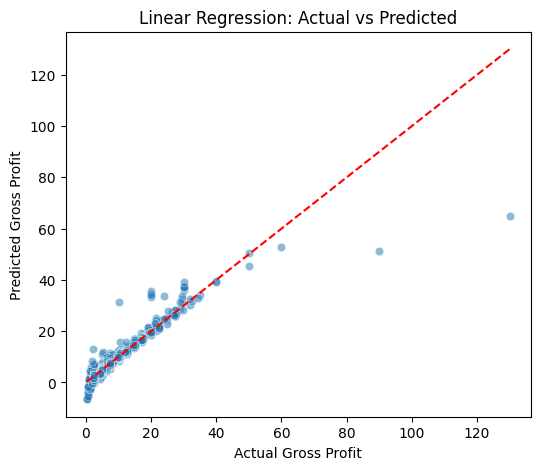

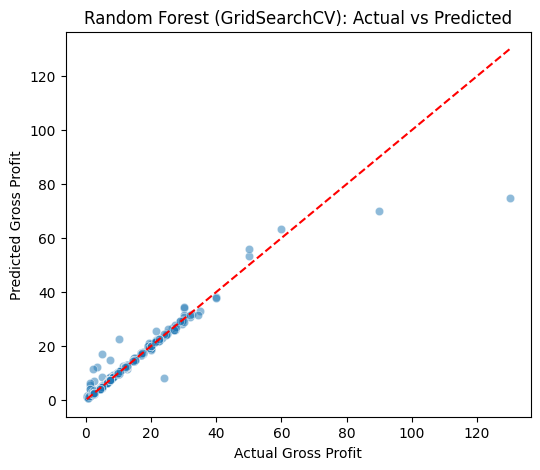

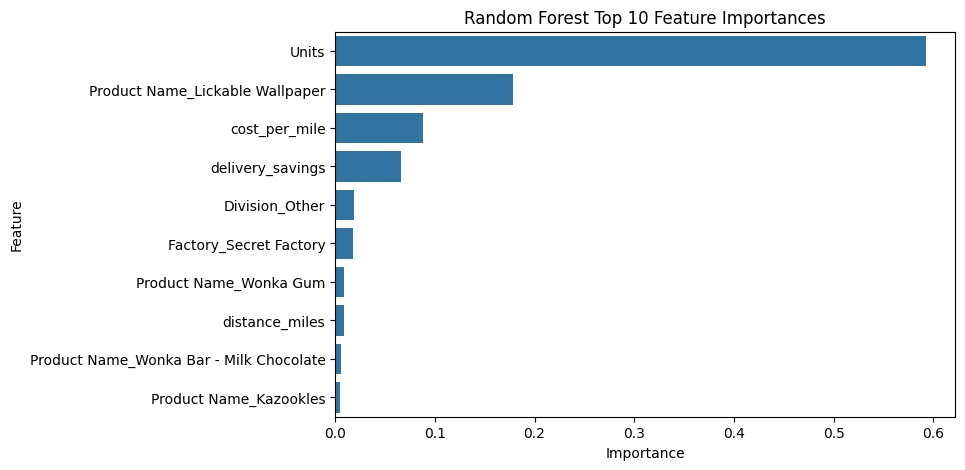

In [33]:

# -------------------------------
# 7.4 Visualizations
# -------------------------------
# Include trained models
models_viz = {
    "Linear Regression": lr,
    "Random Forest (GridSearchCV)": best_rf
}

for name, model in models_viz.items():
    preds = model.predict(X_test)
    
    # Actual vs Predicted
    plt.figure(figsize=(6,5))
    sns.scatterplot(x=y_test, y=preds, alpha=0.5)
    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--')
    plt.title(f'{name}: Actual vs Predicted')
    plt.xlabel('Actual Gross Profit')
    plt.ylabel('Predicted Gross Profit')
    plt.show()

# -------------------------------
# 7.5 Random Forest Feature Importance
# -------------------------------
importances = best_rf.feature_importances_
feat_names = X_test.columns

feat_imp_df = pd.DataFrame({
    'Feature': feat_names,
    'Importance': importances
}).sort_values(by='Importance', ascending=False).head(10)

plt.figure(figsize=(8,5))
sns.barplot(x='Importance', y='Feature', data=feat_imp_df)
plt.title('Random Forest Top 10 Feature Importances')
plt.show()


## 8. Model Performance Comparison & Conclusion

## Performance Metrics Summary

| Metric                   | Linear Regression (LR) | Random Forest (RF) | RF Improvement   |
| ------------------------ | ---------------------- | ------------------ | ---------------- |
| **Training MSE**         | 2.870                  | 0.706              | **75.4% better** |
| **Test MSE**             | 4.499                  | 2.199              | **51.1% better** |
| **Training MAE**         | 0.580                  | 0.104              | **82.1% better** |
| **Test MAE**             | 0.625                  | 0.156              | **75.0% better** |
| **Training R²**          | 0.935                  | 0.984              | **+5.2% higher** |
| **Test R²**              | 0.896                  | 0.949              | **+5.9% higher** |
| **Cross-Validation MAE** | 0.665                  | 0.157              | **76.4% better** |


**Interpretation**: 
1. Linear Regression (LR) 
    R² = 0.896: Explains ~90% of the variance in the target variable - strong but leaves more unexplained variance than RF.    Test MSE = 4.499: Moderate squared error, indicates some residual errors remain.
    Test MAE = 0.625: Average prediction error is ~0.63 units.
    CV_MAE = 0.665: Cross-validated MAE roughly matches test MAE, suggesting LR generalizes reasonably well.
Key insight: LR is simple and interpretable. It captures general trends in profit drivers, such as how units, distance, cost per mile, and shipping time affect the target. However, it may miss non-linear interactions between numeric and categorical features (e.g., product type x shipping region x factory), limiting its precision for detailed operational decisions. 

2. Random Forest (RF, GridSearchCV)
    R² = 0.949: Explains ~95% of variance on test data - relative improvement over LR.
    Test MSE = 2.199: Significantly lower squared error than LR, indicating better fit.
    Test MAE = 0.156: Errors are very small, predictions are highly accurate.
    CV_MAE = 0.157: Nearly identical to test MAE, confirming strong generalization.
Key insight: RF captures complex, non-linear relationships and feature interactions that LR misses. Predictions are highly accurate with minimal error m making it suitable operational decision-making such as factory switching, logistics routing, and prioritizing products.

**Conclusion**: RF (GridSearchCV) is the superior model and provides actionable predictions for logistics and profit optimization
LR remains valuable for high-level insights where interpretability matters, but its prediction lacks the precision required for detailed operational strategy. 


**Overfitting Check**:
   RF provides much better predictive accuracy while keeping overfitting under control.
   LR generalizes reasonably well; test metrics are not far from training metrics.

## 9. What-If Scenario Analysis Tool

In [34]:
# Define features used in the RF model
numeric_features = ['Units', 'distance_miles', 'cost_per_mile', 'delivery_savings']
categorical_features = ['Product Name','Country/Region', 'city', 'Ship Mode','Factory', 'State/Province','Division', 'Region']

# Full feature matrix
X_full = pd.get_dummies(
    sales_df[numeric_features + categorical_features],
    columns=categorical_features,
    drop_first=True
)

# Ensure same columns as model expects
X_full = X_full.reindex(columns=best_rf.feature_names_in_, fill_value=0)

# Predict for all rows
sales_df['Predicted_GP'] = best_rf.predict(X_full)

# Save Tableau-ready file
tableau_path = "/Users/debbiego/Desktop/Myfolder/Capstone/data/candy_distributor_tableau.csv"
sales_df.to_csv(tableau_path, index=False)

print(f"Tableau-ready file saved here: {tableau_path}")

Tableau-ready file saved here: /Users/debbiego/Desktop/Myfolder/Capstone/data/candy_distributor_tableau.csv


In [ ]:

# ===============================================================
# STEP 9 Interactive What-If Scenario Business-Friendly Tool
# ===============================================================

def run_what_if_scenario(order_idx, new_factory, new_ship_mode, new_units):
    """
    Predicts Gross Profit and calculates the impact for a hypothetical scenario
    based on user inputs from an interactive widget.
    """
    # --- 1. Handle "No Change" selections ---
    # Convert descriptive "(No Change)" back to None for logic
    if new_factory == '(No Change)': new_factory = None
    if new_ship_mode == '(No Change)': new_ship_mode = None

    # --- 2. Get Original Order Details ---
    base_order = sales_df.loc[order_idx].copy()
    X_base_encoded = pd.get_dummies(pd.DataFrame([base_order]), columns=categorical_features)
    X_base_aligned = X_base_encoded.reindex(columns=best_rf.feature_names_in_, fill_value=0)
    current_pred_gp = best_rf.predict(X_base_aligned)[0]

    # --- 3. Build New Scenario ---
    scenario = base_order.copy()
    if new_factory is not None:
        scenario['Factory'] = new_factory
    if new_units is not None:
        scenario['Units'] = new_units
    if new_ship_mode is not None:
        scenario['Ship Mode'] = new_ship_mode

    # --- 4. Update dependent features ---
    if new_factory is not None and new_factory != base_order['Factory']:
        factory_coords = factories.loc[factories['Factory'] == new_factory, ['Latitude', 'Longitude']].values[0]
        new_distance = haversine_vectorized(
            scenario['lat_customer'], scenario['lng_customer'],
            factory_coords[0], factory_coords[1]
        )
        scenario['distance_miles'] = new_distance
    else:
        new_distance = scenario['distance_miles'] # Use original distance if factory is unchanged

    # --- 5. Predict New GP ---
    X_new_encoded = pd.get_dummies(pd.DataFrame([scenario]), columns=categorical_features)
    X_new_aligned = X_new_encoded.reindex(columns=best_rf.feature_names_in_, fill_value=0)
    new_pred_gp = best_rf.predict(X_new_aligned)[0]

    # --- 6. Prepare summary ---
    profit_impact = new_pred_gp - current_pred_gp
    distance_impact = scenario['distance_miles'] - base_order['distance_miles']

    summary_data = {
        "Metric": ["Original Order", "New Scenario", "Impact"],
        "Gross Profit": [f"${current_pred_gp:.2f}", f"${new_pred_gp:.2f}", f"{profit_impact:+.2f}"],
        "Factory": [base_order['Factory'], scenario['Factory'], ""],
        "Units": [base_order['Units'], scenario['Units'], ""],
        "Ship Mode": [base_order['Ship Mode'], scenario['Ship Mode'], ""],
        "Distance (miles)": [f"{base_order['distance_miles']:.1f}", f"{scenario['distance_miles']:.1f}", f"{distance_impact:+.1f}"]
    }
    summary_df = pd.DataFrame(summary_data).set_index("Metric")

    # --- 7. Style the output for clarity ---
    def highlight_impact(val):
        # Check if the value is a number (for the 'Impact' row)
        try:
            val_num = float(val)
            if val_num > 0: return "color: green; font-weight: bold;"
            if val_num < 0: return "color: red; font-weight: bold;"
        except ValueError:
            pass # Not a number, so no style
        return ""

    # FIXED: Use .map() instead of the deprecated .applymap()
    styled_df = summary_df.style.map(highlight_impact, subset=["Gross Profit", "Distance (miles)"])
    
    # Clear previous output and display the new styled table
    clear_output(wait=True)
    display(styled_df)

# ===============================================================
# STEP 2: Configure the Interactive Widgets
# ===============================================================

# --- Create cleaner options for the Order dropdown ---
sorted_sales = sales_df.drop_duplicates(subset=['Order ID']).sort_values(by='Order ID', ascending=False)
# CHANGED: Use the Order ID string as the label and the DataFrame index as the value
order_options = list(zip(sorted_sales['Order ID'], sorted_sales.index))

# --- Define the widgets ---
order_selector = widgets.Dropdown(
    options=order_options,
    description='Select Order:',
    style={'description_width': 'initial'}
)

factory_selector = widgets.Dropdown(
    # CHANGED: Added a user-friendly "(No Change)" option
    options=['(No Change)'] + list(factories['Factory'].unique()),
    description='New Factory:',
    style={'description_width': 'initial'}
)

units_slider = widgets.IntSlider(
    min=1, max=100, step=1, # Increased max for more flexibility
    value=sales_df.loc[order_options[0][1], 'Units'], # Set initial value from first order
    description='New Units:',
    style={'description_width': 'initial'}
)

ship_mode_selector = widgets.Dropdown(
    # CHANGED: Added a user-friendly "(No Change)" option
    options=['(No Change)'] + list(sales_df['Ship Mode'].unique()),
    description='New Ship Mode:',
    style={'description_width': 'initial'}
)


# ===============================================================
# STEP 3: Build the User Interface and Link Widgets to the Function
# ===============================================================

# This creates an output area that will be controlled by our function
output_area = widgets.interactive_output(run_what_if_scenario, {
    'order_idx': order_selector,
    'new_factory': factory_selector,
    'new_ship_mode': ship_mode_selector,
    'new_units': units_slider
})

# Arrange controls into a vertical box
controls = widgets.VBox([
    order_selector,
    factory_selector,
    units_slider,
    ship_mode_selector
])

# Display the final User Interface: controls on top of the output table 
display(widgets.VBox([controls, output_area]))
